# Imports

In [ ]:
"""
Colourization of CIFAR-10 Horses via classification.
"""
import argparse
import math
import time

import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import numpy.random as npr
import scipy.misc
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import Variable

In [ ]:
######################################################################
# Setup working directory
######################################################################
%mkdir -p /content/a3/
%cd /content/a3


In [ ]:
######################################################################
# Helper functions for loading data
######################################################################
# adapted from
# https://github.com/fchollet/keras/blob/master/keras/datasets/cifar10.py

import os
import pickle
import sys
import tarfile

import numpy as np
from PIL import Image
from six.moves.urllib.request import urlretrieve


def get_file(fname, origin, untar=False, extract=False, archive_format="auto", cache_dir="data"):
    datadir = os.path.join(cache_dir)
    if not os.path.exists(datadir):
        os.makedirs(datadir)

    if untar:
        untar_fpath = os.path.join(datadir, fname)
        fpath = untar_fpath + ".tar.gz"
    else:
        fpath = os.path.join(datadir, fname)

    print("File path: %s" % fpath)
    if not os.path.exists(fpath):
        print("Downloading data from", origin)

        error_msg = "URL fetch failure on {}: {} -- {}"
        try:
            try:
                urlretrieve(origin, fpath)
            except URLError as e:
                raise Exception(error_msg.format(origin, e.errno, e.reason))
            except HTTPError as e:
                raise Exception(error_msg.format(origin, e.code, e.msg))
        except (Exception, KeyboardInterrupt) as e:
            if os.path.exists(fpath):
                os.remove(fpath)
            raise

    if untar:
        if not os.path.exists(untar_fpath):
            print("Extracting file.")
            with tarfile.open(fpath) as archive:
                archive.extractall(datadir)
        return untar_fpath

    if extract:
        _extract_archive(fpath, datadir, archive_format)

    return fpath


def load_batch(fpath, label_key="labels"):
    """Internal utility for parsing CIFAR data.
    # Arguments
        fpath: path the file to parse.
        label_key: key for label data in the retrieve
            dictionary.
    # Returns
        A tuple `(data, labels)`.
    """
    f = open(fpath, "rb")
    if sys.version_info < (3,):
        d = pickle.load(f)
    else:
        d = pickle.load(f, encoding="bytes")
        # decode utf8
        d_decoded = {}
        for k, v in d.items():
            d_decoded[k.decode("utf8")] = v
        d = d_decoded
    f.close()
    data = d["data"]
    labels = d[label_key]

    data = data.reshape(data.shape[0], 3, 32, 32)
    return data, labels


def load_cifar10(transpose=False):
    """Loads CIFAR10 dataset.
    # Returns
        Tuple of Numpy arrays: `(x_train, y_train), (x_test, y_test)`.
    """
    dirname = "cifar-10-batches-py"
    origin = "http://www.cs.toronto.edu/~kriz/cifar-10-python.tar.gz"
    path = get_file(dirname, origin=origin, untar=True)

    num_train_samples = 50000

    x_train = np.zeros((num_train_samples, 3, 32, 32), dtype="uint8")
    y_train = np.zeros((num_train_samples,), dtype="uint8")

    for i in range(1, 6):
        fpath = os.path.join(path, "data_batch_" + str(i))
        data, labels = load_batch(fpath)
        x_train[(i - 1) * 10000 : i * 10000, :, :, :] = data
        y_train[(i - 1) * 10000 : i * 10000] = labels

    fpath = os.path.join(path, "test_batch")
    x_test, y_test = load_batch(fpath)

    y_train = np.reshape(y_train, (len(y_train), 1))
    y_test = np.reshape(y_test, (len(y_test), 1))

    if transpose:
        x_train = x_train.transpose(0, 2, 3, 1)
        x_test = x_test.transpose(0, 2, 3, 1)
    return (x_train, y_train), (x_test, y_test)

In [ ]:
# Download CIFAR dataset
m = load_cifar10()

## Part 1. Data Preparation [7 pt]

To start off run the above code to load the CIFAR dataset and then work through the following questions/tasks. 

### Part (a) [1pt]
Verify that the dataset has loaded correctly. How many samples do we have? How is the data organized?

In [ ]:
# code to examine the dataset
train_data, test_data=m

In [ ]:
x_train, y_train= train_data

In [ ]:
x_test, y_test= test_data

In [ ]:
print(x_train.shape)
print(y_train.shape)

(50000, 3, 32, 32)
(50000, 1)


In [ ]:
print(x_test.shape)
print(y_test.shape)

(10000, 3, 32, 32)
(10000, 1)


**Answer:**
- We have 50,000 samples in the train set and 10,000 samples in the test set. 
- x_train and x_test have 32*32 RGB images. 
- The y_train and y_test have the labels which denote the class the image belongs to.

### Part (b) [2pt]
Preprocess the data to select only images of horses. Learning to generate only hourse images will make our task easier. Your function will also convert the colour images to greyscale to create our input data.

In [ ]:
# select a single category.
HORSE_CATEGORY = 7

# convert colour images into greyscale
def process(xs, ys, max_pixel=256.0, downsize_input=False):
    """
    Pre-process CIFAR10 images by taking only the horse category,
    shuffling, and have colour values be bound between 0 and 1

    Args:
      xs: the colour RGB pixel values
      ys: the category labels
      max_pixel: maximum pixel value in the original data
    Returns:
      xs: value normalized and shuffled colour images
      grey: greyscale images, also normalized so values are between 0 and 1
    """
    xs = xs / max_pixel
    xs = xs[np.where(ys == HORSE_CATEGORY)[0], :, :, :]
    npr.shuffle(xs)

    grey = np.mean(xs, axis=1, keepdims=True)

    if downsize_input:
        downsize_module = nn.Sequential(
            nn.AvgPool2d(2),
            nn.AvgPool2d(2),
            nn.Upsample(scale_factor=2),
            nn.Upsample(scale_factor=2),
        )
        xs_downsized = downsize_module.forward(torch.from_numpy(xs).float())
        xs_downsized = xs_downsized.data.numpy()
        return (xs, xs_downsized)
    else:
        return (xs, grey)


In [ ]:
x_train_RGB_shuffled, x_train_grey= process(x_train, y_train)

In [ ]:
x_test_RGB_shuffled, x_test_grey= process(x_test, y_test)

In [ ]:
print(x_train_grey.shape)
print(x_test_grey.shape)

(5000, 1, 32, 32)
(1000, 1, 32, 32)


**Answer:**
We have 5000 greyscale horse images in the train set and 1000 greyscale horse images in the test set. We know it is greyscale now sine we have only 1 output channel for each sample image.

### Part (c) [2pt]
Create a dataloader (or function) to batch the samples.

In [ ]:
# dataloader for batching samples

def get_batch(x, y, batch_size):
    """
    Generated that yields batches of data

    Args:
      x: input values
      y: output values
      batch_size: size of each batch
    Yields:
      batch_x: a batch of inputs of size at most batch_size
      batch_y: a batch of outputs of size at most batch_size
    """
    N = np.shape(x)[0]
    assert N == np.shape(y)[0]
    for i in range(0, N, batch_size):
        batch_x = x[i : i + batch_size, :, :, :]
        batch_y = y[i : i + batch_size, :, :, :]
        yield (batch_x, batch_y)

In [ ]:
x_test_grey.shape

(1000, 1, 32, 32)

In [ ]:
x_train_batch, y_train_batch= next(iter(get_batch(x_train_grey, x_train_RGB_shuffled, 100)))

In [ ]:
x_test_batch, y_test_batch= next(iter(get_batch(x_test_grey, x_test_RGB_shuffled, 100)))

In [ ]:
print(x_train_batch.shape, y_train_batch.shape)

(100, 1, 32, 32) (100, 3, 32, 32)


In [ ]:
print(x_test_batch.shape, y_test_batch.shape)

(100, 1, 32, 32) (100, 3, 32, 32)


### Part (e) [2pt]
Verify and visualize that we are able to generate different batches of data.

In [ ]:
# code to load different batches of horse dataset

print("Loading data...")
(x_train, y_train), (x_test, y_test) = load_cifar10()

print("Transforming data...")
train_rgb, train_grey = process(x_train, y_train)
test_rgb, test_grey = process(x_test, y_test)


Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...


In [ ]:
# shape of data and labels before selection
print(x_train.shape, y_train.shape)

(50000, 3, 32, 32) (50000, 1)


In [ ]:
# shape of training data
print('Training Data: ', train_rgb.shape, train_grey.shape)
# shape of testing data
print('Testing Data: ', test_rgb.shape, test_grey.shape)

Training Data:  (5000, 3, 32, 32) (5000, 1, 32, 32)
Testing Data:  (1000, 3, 32, 32) (1000, 1, 32, 32)


Load Batches

In [ ]:
# obtain batches of images
xs, ys = next(iter(get_batch(train_grey, train_rgb, 10)))
print(xs.shape, ys.shape)

(10, 1, 32, 32) (10, 3, 32, 32)


Visualization

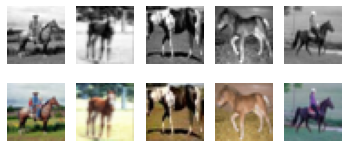

In [ ]:
# obtain one batch of train images

xs_train, ys_train = next(iter(get_batch(train_grey, train_rgb, 5))) # We get first 5 images in test set

# Converting numpy arrays torch tensors
xs_grey = torch.from_numpy(xs_train).float() #NCHW
ys_rgb = torch.from_numpy(ys_train).float()


#correct image structure
xs_grey = np.transpose(xs_grey[:5, :, :, :], [0, 2, 3, 1]).squeeze()  # Get the first 5 tensors
ys_rgb = np.transpose(ys_rgb[:5, :, :, :], [0, 2, 3, 1])   # Get the first 5 tensors

for i in range(5):
    ax = plt.subplot(3, 5, i + 1)
    ax.imshow(xs_grey[i], cmap='gray')
    ax.axis("off")
    ax = plt.subplot(3, 5, i + 1 + 5)
    ax.imshow(ys_rgb[i])
    ax.axis("off")
plt.show()

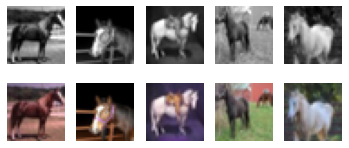

In [ ]:
# obtain one batch of test images

xs_test, ys_test = next(iter(get_batch(test_grey, test_rgb, 5))) # We get first 5 images in test set

xs_grey = torch.from_numpy(xs_test).float()
ys_rgb = torch.from_numpy(ys_test).float()


#correct image structure
xs_grey = np.transpose(xs_grey[:5, :, :, :], [0, 2, 3, 1]).squeeze()
ys_rgb = np.transpose(ys_rgb[:5, :, :, :], [0, 2, 3, 1])

for i in range(5):
    ax = plt.subplot(3, 5, i + 1)
    ax.imshow(xs_grey[i], cmap='gray')
    ax.axis("off")
    ax = plt.subplot(3, 5, i + 1 + 5) # Positions the rgb image after moving 5 indexs so that it is positioned right at the bottom
    ax.imshow(ys_rgb[i])
    ax.axis("off")
plt.show()

# PART B - Conditional GAN [30 pt]

In this second half of the assignment we will construct a conditional generative adversarial network for our image colourization task.

## Part 1. Conditional GAN [15 pt]

To start we will be modifying the previous sample code to construct and train a conditional GAN. We will exploring the different architectures to identify and select our best image colourization model.

Note: This second half of the assignment should be started after the lecture on generative adversarial networks (GANs). 


### Part (a) [3 pt]
Modify the provided training code to implement a generator. Then test to verify it works on the desired input (Hint: you can reuse some of your earlier autoencoder models here to act as a generator)

**Answer**
At first I tried using my skip connection Unet as the conditional GAN genertor but it did not generate good RGB images (cells not shown). Hence, I used the RegressionCNN from above and modified that to have skip connections and take the grey image as a condition. 

Architecrure specifications:
- I used kernel size of 3
- num_filters of 64
- grey image as input to my generator

In [ ]:
class Generator(nn.Module):
    def __init__(self, kernel=3, num_filters=64, num_colours=3, num_in_channels=1):
        # first call parent's initialization function
        super().__init__()

        # Useful parameters
        stride = 2
        padding = kernel // 2
        output_padding = 1
        

        self.downconv1 = nn.Sequential(
            nn.Conv2d(1, num_filters, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters),
            nn.ReLU(),
            nn.MaxPool2d(2),)
        self.downconv2 = nn.Sequential(
            nn.Conv2d(num_filters, num_filters*2, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters*2),
            nn.ReLU(),
            nn.MaxPool2d(2),)

        self.rfconv = nn.Sequential(
            nn.Conv2d(num_filters*2, num_filters*2, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters*2),
            nn.ReLU())

        self.upconv1 = nn.Sequential(
            nn.Conv2d(num_filters*2+ num_filters*2, num_filters, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters),
            nn.ReLU(),
            nn.Upsample(scale_factor=2),)
        self.upconv2 = nn.Sequential(
            nn.Conv2d(num_filters+num_filters, 3, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(3),
            nn.ReLU(),
            nn.Upsample(scale_factor=2),)
        self.finalconv = nn.Conv2d(3+ num_in_channels, 3, kernel_size=kernel, padding=padding)

    def forward(self, x):
        out1 = self.downconv1(x)
        out2 = self.downconv2(out1)
        out3 = self.rfconv(out2)

        out = self.upconv1(torch.cat([out3, out2], dim=1))
        out = self.upconv2(torch.cat([out, out1], dim=1))
        out = torch.sigmoid(self.finalconv(torch.cat([out, x], dim=1)))
        return out

In [ ]:
#test generator architecture

# Load the data
(x_train, y_train), (x_test, y_test) = load_cifar10()

# Get only horse images 
train_rgb, train_grey = process(x_train, y_train) #Training Data:  (5000, 3, 32, 32) (5000, 1, 32, 32)
test_rgb, test_grey = process(x_test, y_test) #Testing Data:  (1000, 3, 32, 32) (1000, 1, 32, 32)

# obtain one batch of train images # batch of 5
xs_train, ys_train = next(iter(get_batch(train_grey, train_rgb, 5))) # We get first 5 images in test set # In numpy format

# Converting numpy arrays torch tensors
xs_grey = torch.from_numpy(xs_train).float() #NCHW # in torch format
ys_rgb = torch.from_numpy(ys_train).float()




File path: data/cifar-10-batches-py.tar.gz


In [ ]:
xs_grey[0,:,:,:].shape # 1 img

torch.Size([1, 32, 32])

In [ ]:
# We want to pass 5 grey images to the generator and plot the ouput we get
model= Generator() # in_c=1, num_filters=64
print(model)
model= model.to('cuda')

Generator(
  (downconv1): Sequential(
    (0): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (downconv2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (rfconv): Sequential(
    (0): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (upconv1): Sequential(
    (0): Conv2d(256, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=Tru

In [ ]:
#one_grey_img= xs_grey[0,:,:,:]  # One image at a time doesn't work.
pred= model.forward(xs_grey.cuda()) # A batch of 5 images 
pred.shape

torch.Size([5, 3, 32, 32])

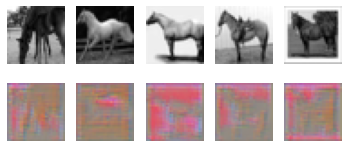

In [ ]:
# Now if we wanted to plot these predicted images:

# Plotting the images

#correct image structure
xs_grey = np.transpose(xs_grey[:5, :, :, :], [0, 2, 3, 1]).squeeze()  # Get the first 5 tensors
  
pred= pred.detach().cpu()
pred = np.transpose(pred[:5, :, :, :], [0, 2, 3, 1]) # Get the first 5 tensors



for i in range(5):
    ax = plt.subplot(3, 5, i + 1)
    ax.imshow(xs_grey[i], cmap='gray')
    ax.axis("off")
    ax = plt.subplot(3, 5, i + 1 + 5)
    ax.imshow(pred[i])
    ax.axis("off")
plt.show()

**Answer**
We can see that the output image has preserved the content of horse images but definitly did a poor job in coloring the images. This is because we haven't yet trained out model so the weights are doing a poor job. This was done just to check if the output images preserve the content of the greyscale image and check if our generator has any syntax error. Looking at the pictures above we can see it has some patterns of every corresponding horse image and so is able to preserve it.

Note: cuda--> load the model, load the input. Then if you want to make chnages to the input--> need to deatch from cuda and make chnages to print

### Part (b) [3 pt]
Modify the provided training code to implement a discriminator. Then test to verify it works on the desired input.

In [ ]:
# discriminator code 

class Discriminator(nn.Module):
    def __init__(self, kernel=2, num_filters=64, num_colours=3, num_in_channels=1):
        super().__init__()
        
        # Useful parameters
        stride = 2
        padding = kernel // 2
        output_padding = 1

        ############### YOUR CODE GOES HERE ############### 
        ###################################################


        #Conv feature extractor and Classifier 

        self.conv1 = nn.Conv2d(3+1, 64, 2, stride= stride, padding= padding)  # padding=2//2 =floor(1)= 1 #n_out= 17 # takes in RGB + greyscale img
        self.conv2= nn.Conv2d(64, 128, 2, stride=stride, padding=padding)  # n_out= 9.5= 9
        self.conv3= nn.Conv2d(128, 256, 2, stride=stride, padding=padding) # n_out= 5.5=5
        self.conv4= nn.Conv2d(256, 512, 2, stride=stride, padding=padding) # n_out= 3.5=3
        self.conv5= nn.Conv2d(512, 1024, 2) # n_out= 2

        self.fc1 = nn.Linear(1024 * 2 * 2, 100)
        self.fc2 = nn.Linear(100, 1) # 1 ouput node #outputs 1D labels (fake or real)

    
    
    def forward(self, x, img_greyscale):
        
        ############### YOUR CODE GOES HERE ###############
        ###################################################

        x = torch.cat([x, img_greyscale], dim=1) # N x C x H x W

        x = F.leaky_relu(self.conv1(x))
        x = F.leaky_relu(self.conv2(x))
        x = F.leaky_relu(self.conv3(x)) 
        x = F.leaky_relu(self.conv4(x)) 
        x = F.leaky_relu(self.conv5(x)) # Encoding layer

        x = x.view(-1, 1024 * 2 * 2)
        x = F.leaky_relu(self.fc1(x))
        x = torch.sigmoid(self.fc2(x))  # sigmoid chosen since binary ouptut and so we are not using BCEwithlogits
        #x = x.squeeze(1)

        out= x.squeeze()  # doesn't work without squeeze #Sequeezes the tensore to be a scalar

        return out

In [ ]:
# test discriminator architecture

# Get the batch of 5 images from train set
# Converting numpy arrays torch tensors
xs_grey = torch.from_numpy(xs_train).float() #NCHW # in torch format
ys_rgb = torch.from_numpy(ys_train).float()


In [ ]:
ys_rgb[:,:,:,:].shape # 1 img

torch.Size([5, 3, 32, 32])

In [ ]:
xs_grey[:,:,:,:].shape

torch.Size([5, 1, 32, 32])

In [ ]:
# We want to pass 5 grey images to the generator and plot the ouput we get
model= Discriminator()
print(model)
model= model.to('cuda')

Discriminator(
  (conv1): Conv2d(4, 64, kernel_size=(2, 2), stride=(2, 2), padding=(1, 1))
  (conv2): Conv2d(64, 128, kernel_size=(2, 2), stride=(2, 2), padding=(1, 1))
  (conv3): Conv2d(128, 256, kernel_size=(2, 2), stride=(2, 2), padding=(1, 1))
  (conv4): Conv2d(256, 512, kernel_size=(2, 2), stride=(2, 2), padding=(1, 1))
  (conv5): Conv2d(512, 1024, kernel_size=(2, 2), stride=(1, 1))
  (fc1): Linear(in_features=4096, out_features=100, bias=True)
  (fc2): Linear(in_features=100, out_features=1, bias=True)
)


In [ ]:
#one_grey_img= xs_grey[0,:,:,:]  # One image at a time doesn't work.
pred= model.forward(ys_rgb.cuda(), xs_grey.cuda() ) # A batch of 5 images 
pred.shape

torch.Size([5])

In [ ]:
pred

tensor([0.4973, 0.4972, 0.4971, 0.4971, 0.4973], device='cuda:0',
       grad_fn=<SqueezeBackward0>)

**Answer**
We can see that the output is 5 probability scores within the range 0 and 1. Right now the discriminator is manking random guesss (50%) since it has not yet been trained. But we know that our architecture is fine since it is able to take a color image along with it's grey version and predict 1 probablity.

### Part (c) [3 pt]
Modify the provided training code to implement a conditional GAN.

In [ ]:
# Lecture's approach to compute loss
def discriminator_train_step(batch_size, discriminator, generator, d_optimizer, criterion, colored_real_images, grey_imgs):
    
    fake_images = generator(grey_imgs)

    inputs= torch.cat([colored_real_images,fake_images])
    labels= torch.cat([torch.ones(batch_size), torch.zeros(batch_size)])  # fake label--> 0 , real label--> 1

    grey_inputs= torch.cat([grey_imgs,grey_imgs])

    d_outputs = discriminator(Variable(inputs.cuda()), Variable(grey_inputs.cuda()))
    d_loss= criterion(d_outputs, Variable(labels.cuda()))

    d_loss.backward()
    d_optimizer.step()
    # return d_loss.data[0]

    d_optimizer.zero_grad()
    
    return d_loss


In [ ]:
def generator_train_step(batch_size, discriminator, generator, g_optimizer, criterion, grey_imgs):
  
  
  fake_images = generator(grey_imgs)

  validity = discriminator(fake_images, grey_imgs) 
  g_loss = criterion(validity, Variable(torch.ones(batch_size)).cuda()) # We compute loss against tensor of ones since if discriminator outputs 1 it means it thought thta the image was real. And that is what we want. We want to fool the discriminator. So loss is low when discrinimator predicted mostly wrong # real label--> 1 # We see how many times discriminator misclassifies as real
  
  g_loss.backward()
  g_optimizer.step()
  g_optimizer.zero_grad()
  

  # return g_loss.data[0]
  return g_loss, fake_images


In [ ]:
# visualize 5 train/test images
def visual(img_grey, img_real, img_fake, gpu = 0, flag_torch = 0):

  if gpu:
    img_grey = img_grey.cpu().detach()
    img_real = img_real.cpu().detach()
    img_fake = img_fake.cpu().detach()

  if flag_torch:
    img_grey = img_grey.numpy()
    img_real = img_real.numpy()
    img_fake = img_fake.numpy()

  if flag_torch == 2:
    img_real = np.transpose(img_real[:, :, :, :, :], [0, 4, 2, 3, 1]).squeeze()
    img_fake = np.transpose(img_fake[:, :, :, :, :], [0, 4, 2, 3, 1]).squeeze()

  #correct image structure
  img_grey = np.transpose(img_grey[:5, :, :, :], [0, 2, 3, 1]).squeeze()
  img_real = np.transpose(img_real[:5, :, :, :], [0, 2, 3, 1])
  img_fake = np.transpose(img_fake[:5, :, :, :], [0, 2, 3, 1])

  for i in range(5):
      ax = plt.subplot(3, 5, i + 1)
      ax.imshow(img_grey[i], cmap='gray')
      ax.axis("off")
      ax = plt.subplot(3, 5, i + 1 + 5)
      ax.imshow(img_real[i])
      ax.axis("off")
      ax = plt.subplot(3, 5, i + 1 + 10)
      ax.imshow(img_fake[i])
      ax.axis("off")
  plt.show()

In [ ]:
class AttrDict(dict):
    def __init__(self, *args, **kwargs):
        super(AttrDict, self).__init__(*args, **kwargs)
        self.__dict__ = self

def get_torch_vars(xs, ys, gpu=False):
    """
    Helper function to convert numpy arrays to pytorch tensors.
    If GPU is used, move the tensors to GPU.

    Args:
      xs (float numpy tenosor): greyscale input
      ys (int numpy tenosor): categorical labels
      gpu (bool): whether to move pytorch tensor to GPU
    Returns:
      Variable(xs), Variable(ys)
    """
    xs = torch.from_numpy(xs).float()
    ys = torch.from_numpy(ys).float() #--> ADDED for cGAN
    if gpu:
        xs = xs.cuda()
        ys = ys.cuda()
    return Variable(xs), Variable(ys)

def train(args, generator=None):
    # Set the maximum number of threads to prevent crash in Teaching Labs
    # TODO: necessary?
    torch.set_num_threads(5)
    # Numpy random seed
    npr.seed(args.seed)

    # Save directory
    save_dir = "outputs/" + args.experiment_name

    # LOAD THE COLOURS CATEGORIES

    # INPUT CHANNEL
    num_in_channels = 1 if not args.downsize_input else 3
    # LOAD THE MODEL
    if generator is None:
        Net = globals()[args.model]
        generator = Generator() #kernel=3, num_filters=64 by default
        discriminator = Discriminator()


    # LOSS FUNCTION

    criterion =  nn.BCELoss()   # Since we compare discriminator preds vs fake/real img label (instead of pixel values for which we needed MSELoss)                                               
    g_optimizer = torch.optim.Adam(discriminator.parameters(), lr=args.learn_rate)
    d_optimizer = torch.optim.Adam(generator.parameters(), lr=args.learn_rate)

    # DATA
    print("Loading data...")
    (x_train, y_train), (x_test, y_test) = load_cifar10()

    print("Transforming data...")
    train_rgb, train_grey = process(x_train, y_train, downsize_input=args.downsize_input) # no need downsize_input=args.downsize_input since it is False anyways
    test_rgb, test_grey = process(x_test, y_test, downsize_input=args.downsize_input)

    # Create the outputs folder if not created already
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)

    print("Beginning training ...")
    if args.gpu:
        generator.cuda()
        discriminator.cuda()
    
    start = time.time()

    train_losses = []

    valid_losses = []
    valid_accs = []

    for epoch in range(args.epochs):
        # Train the Model
        generator.train()
        discriminator.train()
        losses = []
 
        for i, (xs, ys) in enumerate(get_batch(train_grey, train_rgb, args.batch_size)): # # We get a batch of images in train set
            grey_images, color_images = get_torch_vars(xs, ys, args.gpu)  # Converts numpy to tensors and into float type. Also load them to cuda using Varible(img.cuda())

            #--->ADDED 5
            img_real = color_images
            img_grey = grey_images # labels
            
            batch_size = args.batch_size
            
            ####### Discriminator training ##########
            d_loss = discriminator_train_step(batch_size, discriminator, generator, d_optimizer, criterion, img_real, img_grey)
            

            ####### Generator training ##########
            g_loss, outputs = generator_train_step(batch_size, discriminator, generator, g_optimizer, criterion, img_grey)
            


        # print and visualize
        print(epoch, g_loss.cpu().detach(), d_loss.cpu().detach())
        generator.eval()
        #print(epoch, g_loss, d_loss)
        visual(grey_images, color_images, outputs, args.gpu, 1)  # Tell visual that need to detach from cuda and also all images are in tensor format (so need to convert to numpy to plot using img.numpy()

    return generator


### Part (d) [3 pt]
Train a conditional GAN for image colourization.

In [ ]:
import torch
torch.cuda.empty_cache()

In [ ]:
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "Generator",
    "kernel": 3,
    "num_filters": 64,
    'learn_rate':0.001, 
    "batch_size": 200,
    "epochs": 100,
    "seed": 0,
    "plot": False,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}
args.update(args_dict)
generator = train(args) 

**Answer**
The color prediction with batch size 200 and learning arte 0.001 is very poor compared to all out previous autoencoder models. This could be beacuse the model is chnaging the color predictions too fast going from pink to green then blue and so I think we need to decrease the learning rate. I will also decrease the batch size from 200 to 50 so that the model can have time to look more closely at a smaller batch and predict their color accutarely as opposed averaging out colors of bigger bathces of images. 

batch size= 50, epoch=100, learning rate=0.0001 

In [ ]:
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "Generator",
    "kernel": 3,
    "num_filters": 64,
    'learn_rate':0.0001, 
    "batch_size": 50,
    "epochs": 100,
    "seed": 0,
    "plot": False,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}
args.update(args_dict)
generator = train(args)  # should return your generator. So cnn is your generator

**Answer**
It looks lie out model was doing better around 30-50 epochs and performce again fell after that. This could be because our batches were too small and modek is uable to generalize.

In [ ]:
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "Generator",
    "kernel": 3,
    "num_filters": 64,
    'learn_rate':0.001, 
    "batch_size": 500,
    "epochs": 100,
    "seed": 0,
    "plot": False,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}
args.update(args_dict)
generator = train(args) 

### Part (e) [1 pt]
How does the performance of the cGAN compare with the autoencoder models that you tested in the first half of this assignment?

**Answer**
As we can see finding the correct hyperparamters for a conditional GAN is much more difficult than our previous UNet or regression CNN. This could be because our discriminator is too good in recognizing an image as fake that the generatot doesn't know what color to produce to get rewarded. 

### Part (f) [2 pt]

A colour space is a choice of mapping of colours into three-dimensional coordinates. Some colours could be close together in one colour space, but further apart in others. The RGB colour space is probably the most familiar to you, the model used in in our regression colourization example computes squared error in RGB colour space. But, most state of the art colourization models
do not use RGB colour space. How could using the RGB colour space be problematic? Your answer should relate how human perception of colour is different than the squared distance. You may use the Wikipedia article on colour space to help you answer the question.

**Answer**

In RGB color space and there are 3 numbers for each pixel indicating how much Red, Green, and Blue the pixel is. In L*a*b color space, we have again three numbers for each pixel but these numbers have different meanings. The first channel indicates the lightness of each pixel (a black and white image), the a and b channles represent how much green-red and yellow-blue each pixel is.

Hence wehn training models it is much easier and faster to used lab color space since it already has the grey image in one of the layers. When using RGB like we did above we first had to convert the RGB image into grey image and then use 1 grey channel to predict 3 RGB channle. But with lab color space the model has to only predict 2 channels ussing the first L channel.  

Furthuremore lab color space produces a colour space that is more perceptually linear than other colour spaces like RGB. Perceptually linear means that a change of the same amount in a colour value should produce a change of about the same visual importance. Thus lab colour space is designed for perceptual uniformity which makes it ideal for computer processing. For these reasons it is better to use lab color space compared to RGB.

## Part 2. Exploration [10 pt]

At this point we have trained a few different generative models for our image colourization task with varying results. What makes this work exciting is that there many other approaches we could take. In this part of the assignment you will be exploring at least one of several approaches towards improving our performance on the image colourization task. Some well known approaches you can consider include:

- lab colour space representation instead of RBG which simplifies the problem and requires you to predict two output channels instead of three
- k-means to represent RBG colourspace by 'k' distinct colours, this effectively changes the problem from regression to classification.

Other interesting approaches include:
- combining L1 loss along with the discriminator-based loss
- starting with a pretrained generator (i.e. Resnet)
- patch discriminator trained on local regions

A great example of some of these different approaches can be found in a <a href="https://towardsdatascience.com/colorizing-black-white-images-with-u-net-and-conditional-gan-a-tutorial-81b2df111cd8">blog post by Moein Shariatnia</a>.

Note you are only required to pick one of the suggested modifications.

**Answer**

Below I have implemented the suggested modification from the paper mentioned above. I have used lab color space to predict only 2 layers and I also used the L1 loss with along the discriminator based loss to improve the color predictions. 

I have used the same cifar10 horse dataset for training our cGAN model.

I have made certain modifications to the code. Sice my skip connection Unet did not generate good RGB images, I used the Unet from the colorization article (https://towardsdatascience.com/colorizing-black-white-images-with-u-net-and-conditional-gan-a-tutorial-81b2df111cd8). 

However I made some modifications to the Unet to enable to process 32x32 images:
- chnaged kernel size from 4 to 2
- chnaged stride from 2 to 1

I reduced the kernel and stride because our image is small 32x32 and larger kernels would result in negative dimension (will get rid of all information) and so the code would give an error.

In [ ]:
import os
import glob
import time
import numpy as np
from PIL import Image
from pathlib import Path
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
from skimage.color import rgb2lab, lab2rgb

import torch
from torch import nn, optim
from torchvision import transforms
from torchvision.utils import make_grid
from torch.utils.data import Dataset, DataLoader
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
use_colab = None

In [ ]:
!pip install fastai==2.4

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


Retriving cifar data and assigning to the relevant parameters for processing and converting into lab space.

In [ ]:
# Retriving cifar data and assigning to the relevant parameters for processing and converting into lab space.
(x_train, y_train), (x_test, y_test) = load_cifar10()
train_rgb, train_grey = process(x_train, y_train)
test_rgb, test_grey = process(x_test, y_test)

train_idxs = train_rgb # choosing the first 8000 as training set
val_idxs = test_rgb # choosing last 2000 as validation set
train_paths = train_idxs
val_paths = val_idxs
print(len(train_paths), len(val_paths))

File path: data/cifar-10-batches-py.tar.gz
5000 1000


In [ ]:
# Modified the code to take in numpy image instead of image paths. 

import numpy as numpy
SIZE = 256
class ColorizationDataset(Dataset):
    def __init__(self, paths, split='train'):
        if split == 'train':
            self.transforms = transforms.Compose([
                transforms.Resize((SIZE, SIZE),  Image.BICUBIC),
                transforms.RandomHorizontalFlip(), # A little data augmentation!
            ])
        elif split == 'val':
            self.transforms = transforms.Resize((SIZE, SIZE),  Image.BICUBIC)
        
        self.split = split
        self.size = SIZE
        self.paths = paths
    
    def __getitem__(self, idx):
        #img = self.paths[idx]
        #img = self.transforms(img)
        img = np.array(self.paths[idx])
        img = numpy.transpose(img, (1, 2, 0))
        img_lab = rgb2lab(img).astype("float32") # Converting RGB to L*a*b
        img_lab = transforms.ToTensor()(img_lab)
        L = img_lab[[0], ...] / 50. - 1. # Between -1 and 1
        ab = img_lab[[1, 2], ...] / 110. # Between -1 and 1
        
        return {'L': L, 'ab': ab}
    
    def __len__(self):
        return len(self.paths)

def make_dataloaders(batch_size=16, n_workers=4, pin_memory=True, **kwargs): # A handy function to make our dataloaders
    dataset = ColorizationDataset(**kwargs)
    dataloader = DataLoader(dataset, batch_size=batch_size, num_workers=n_workers,
                            pin_memory=pin_memory)
    return dataloader

In [ ]:
train_dl = make_dataloaders(paths=train_paths, split='train')
val_dl = make_dataloaders(paths=val_paths, split='val')

data = next(iter(train_dl))
Ls, abs_ = data['L'], data['ab']
print(Ls.shape, abs_.shape)
print(len(train_dl), len(val_dl))


/usr/local/lib/python3.7/dist-packages/torchvision/transforms/transforms.py:333: UserWarning: Argument 'interpolation' of type int is deprecated since 0.13 and will be removed in 0.15. Please use InterpolationMode enum.
  Args:


torch.Size([16, 1, 32, 32]) torch.Size([16, 2, 32, 32])
313 63


In [ ]:
# Made mofications: kernel size= 2, stride =1 to process 32x32 images
# Takes in grey image of 1x32x32
# Outputs 2 channels (a and b of lab color space)

class UnetBlock(nn.Module):
    def __init__(self, nf, ni, submodule=None, input_c=None, dropout=False,
                 innermost=False, outermost=False):
        super().__init__()
        self.outermost = outermost
        if input_c is None: input_c = nf
        downconv = nn.Conv2d(input_c, ni, kernel_size=2,
                             stride=1, padding=1, bias=False)
        downrelu = nn.LeakyReLU(0.2, True)
        downnorm = nn.BatchNorm2d(ni)
        uprelu = nn.ReLU(True)
        upnorm = nn.BatchNorm2d(nf)
        
        if outermost:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=2,
                                        stride=1, padding=1)
            down = [downconv]
            up = [uprelu, upconv, nn.Tanh()]
            model = down + [submodule] + up
        elif innermost:
            upconv = nn.ConvTranspose2d(ni, nf, kernel_size=2,
                                        stride=1, padding=1, bias=False)
            down = [downrelu, downconv]
            up = [uprelu, upconv, upnorm]
            model = down + up
        else:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=2,
                                        stride=1, padding=1, bias=False)
            down = [downrelu, downconv, downnorm]
            up = [uprelu, upconv, upnorm]
            if dropout: up += [nn.Dropout(0.5)]
            model = down + [submodule] + up
        self.model = nn.Sequential(*model)
    
    def forward(self, x):
        if self.outermost:
            return self.model(x)
        else:
            return torch.cat([x, self.model(x)], 1)

class Unet(nn.Module):
    def __init__(self, input_c=1, output_c=2, n_down=8, num_filters=64):
        super().__init__()
        unet_block = UnetBlock(num_filters * 8, num_filters * 8, innermost=True)
        for _ in range(n_down - 5):
            unet_block = UnetBlock(num_filters * 8, num_filters * 8, submodule=unet_block, dropout=True)
        out_filters = num_filters * 8
        for _ in range(3):
            unet_block = UnetBlock(out_filters // 2, out_filters, submodule=unet_block)
            out_filters //= 2
        self.model = UnetBlock(output_c, out_filters, input_c=input_c, submodule=unet_block, outermost=True)
    
    def forward(self, x):
        return self.model(x)

In [ ]:
class PatchDiscriminator(nn.Module):
    def __init__(self, input_c, num_filters=64, n_down=3):
        super().__init__()
        model = [self.get_layers(input_c, num_filters, norm=False)]
        model += [self.get_layers(num_filters * 2 ** i, num_filters * 2 ** (i + 1), s=1 if i == (n_down-1) else 2) 
                          for i in range(n_down)] # the 'if' statement is taking care of not using
                                                  # stride of 2 for the last block in this loop
        model += [self.get_layers(num_filters * 2 ** n_down, 1, s=1, norm=False, act=False)] # Make sure to not use normalization or
                                                                                             # activation for the last layer of the model
        self.model = nn.Sequential(*model)                                                   
        
    def get_layers(self, ni, nf, k=4, s=2, p=1, norm=True, act=True): # when needing to make some repeatitive blocks of layers,
        layers = [nn.Conv2d(ni, nf, k, s, p, bias=not norm)]          # it's always helpful to make a separate method for that purpose
        if norm: layers += [nn.BatchNorm2d(nf)]
        if act: layers += [nn.LeakyReLU(0.2, True)]
        return nn.Sequential(*layers)
    
    def forward(self, x):
        return self.model(x)

In [ ]:
discriminator = PatchDiscriminator(3)
dummy_input = torch.randn(16, 3, 256, 256) # batch_size, channels, size, size
out = discriminator(dummy_input)
out.shape

torch.Size([16, 1, 30, 30])

In [ ]:
# Implements L1 loss along with discriminator loss
class GANLoss(nn.Module):
    def __init__(self, gan_mode='vanilla', real_label=1.0, fake_label=0.0):
        super().__init__()
        self.register_buffer('real_label', torch.tensor(real_label))
        self.register_buffer('fake_label', torch.tensor(fake_label))
        if gan_mode == 'vanilla':
            self.loss = nn.BCEWithLogitsLoss()
        elif gan_mode == 'lsgan':
            self.loss = nn.MSELoss()
    
    def get_labels(self, preds, target_is_real):
        if target_is_real:
            labels = self.real_label
        else:
            labels = self.fake_label
        return labels.expand_as(preds)
    
    def __call__(self, preds, target_is_real):
        labels = self.get_labels(preds, target_is_real)
        loss = self.loss(preds, labels)
        return loss

In [ ]:
def init_weights(net, init='norm', gain=0.02):
    
    def init_func(m):
        classname = m.__class__.__name__
        if hasattr(m, 'weight') and 'Conv' in classname:
            if init == 'norm':
                nn.init.normal_(m.weight.data, mean=0.0, std=gain)
            elif init == 'xavier':
                nn.init.xavier_normal_(m.weight.data, gain=gain)
            elif init == 'kaiming':
                nn.init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')
            
            if hasattr(m, 'bias') and m.bias is not None:
                nn.init.constant_(m.bias.data, 0.0)
        elif 'BatchNorm2d' in classname:
            nn.init.normal_(m.weight.data, 1., gain)
            nn.init.constant_(m.bias.data, 0.)
            
    net.apply(init_func)
    print(f"model initialized with {init} initialization")
    return net

def init_model(model, device):
    model = model.to(device)
    model = init_weights(model)
    return model

In [ ]:
class MainModel(nn.Module):
    def __init__(self, net_G=None, lr_G=2e-4, lr_D=2e-4, 
                 beta1=0.5, beta2=0.999, lambda_L1=100.):
        super().__init__()
        
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.lambda_L1 = lambda_L1
        
        if net_G is None:
            self.net_G = init_model(Unet(input_c=1, output_c=2, n_down=8, num_filters=64), self.device)
        else:
            self.net_G = net_G.to(self.device)
        self.net_D = init_model(PatchDiscriminator(input_c=3, n_down=3, num_filters=64), self.device)
        self.GANcriterion = GANLoss(gan_mode='vanilla').to(self.device)
        self.L1criterion = nn.L1Loss()
        self.opt_G = optim.Adam(self.net_G.parameters(), lr=lr_G, betas=(beta1, beta2))
        self.opt_D = optim.Adam(self.net_D.parameters(), lr=lr_D, betas=(beta1, beta2))
    
    def set_requires_grad(self, model, requires_grad=True):
        for p in model.parameters():
            p.requires_grad = requires_grad
        
    def setup_input(self, data):
        self.L = data['L'].to(self.device)
        self.ab = data['ab'].to(self.device)
        
    def forward(self):
        self.fake_color = self.net_G(self.L)
    
    def backward_D(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image.detach())
        self.loss_D_fake = self.GANcriterion(fake_preds, False)
        real_image = torch.cat([self.L, self.ab], dim=1)
        real_preds = self.net_D(real_image)
        self.loss_D_real = self.GANcriterion(real_preds, True)
        self.loss_D = (self.loss_D_fake + self.loss_D_real) * 0.5
        self.loss_D.backward()
    
    def backward_G(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image)
        self.loss_G_GAN = self.GANcriterion(fake_preds, True)
        self.loss_G_L1 = self.L1criterion(self.fake_color, self.ab) * self.lambda_L1
        self.loss_G = self.loss_G_GAN + self.loss_G_L1
        self.loss_G.backward()
    
    def optimize(self):
        self.forward()
        self.net_D.train()
        self.set_requires_grad(self.net_D, True)
        self.opt_D.zero_grad()
        self.backward_D()
        self.opt_D.step()
        
        self.net_G.train()
        self.set_requires_grad(self.net_D, False)
        self.opt_G.zero_grad()
        self.backward_G()
        self.opt_G.step()

In [ ]:
class AverageMeter:
    def __init__(self):
        self.reset()
        
    def reset(self):
        self.count, self.avg, self.sum = [0.] * 3
    
    def update(self, val, count=1):
        self.count += count
        self.sum += count * val
        self.avg = self.sum / self.count

def create_loss_meters():
    loss_D_fake = AverageMeter()
    loss_D_real = AverageMeter()
    loss_D = AverageMeter()
    loss_G_GAN = AverageMeter()
    loss_G_L1 = AverageMeter()
    loss_G = AverageMeter()
    
    return {'loss_D_fake': loss_D_fake,
            'loss_D_real': loss_D_real,
            'loss_D': loss_D,
            'loss_G_GAN': loss_G_GAN,
            'loss_G_L1': loss_G_L1,
            'loss_G': loss_G}

def update_losses(model, loss_meter_dict, count):
    for loss_name, loss_meter in loss_meter_dict.items():
        loss = getattr(model, loss_name)
        loss_meter.update(loss.item(), count=count)

def lab_to_rgb(L, ab):
    """
    Takes a batch of images
    """
    
    L = (L + 1.) * 50.
    ab = ab * 110.
    Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    rgb_imgs = []
    for img in Lab:
        img_rgb = lab2rgb(img)
        rgb_imgs.append(img_rgb)
    return np.stack(rgb_imgs, axis=0)
    
def visualize(model, data, save=True):
    model.net_G.eval()
    with torch.no_grad():
        model.setup_input(data)
        model.forward()
    model.net_G.train()
    fake_color = model.fake_color.detach()
    real_color = model.ab
    L = model.L
    fake_imgs = lab_to_rgb(L, fake_color)
    real_imgs = lab_to_rgb(L, real_color)
    fig = plt.figure(figsize=(15, 8))
    for i in range(5):
        ax = plt.subplot(3, 5, i + 1)
        ax.imshow(L[i][0].cpu(), cmap='gray')
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 5)
        ax.imshow(fake_imgs[i])
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 10)
        ax.imshow(real_imgs[i])
        ax.axis("off")
    plt.show()
    if save:
        fig.savefig(f"colorization_{time.time()}.png")
        
def log_results(loss_meter_dict):
    for loss_name, loss_meter in loss_meter_dict.items():
        print(f"{loss_name}: {loss_meter.avg:.5f}")

Traning the model with cifar train set images

model initialized with norm initialization
model initialized with norm initialization


  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 1/50
Iteration 200/313
loss_D_fake: 0.47422
loss_D_real: 0.49949
loss_D: 0.48685
loss_G_GAN: 1.84372
loss_G_L1: 9.42181
loss_G: 11.26553


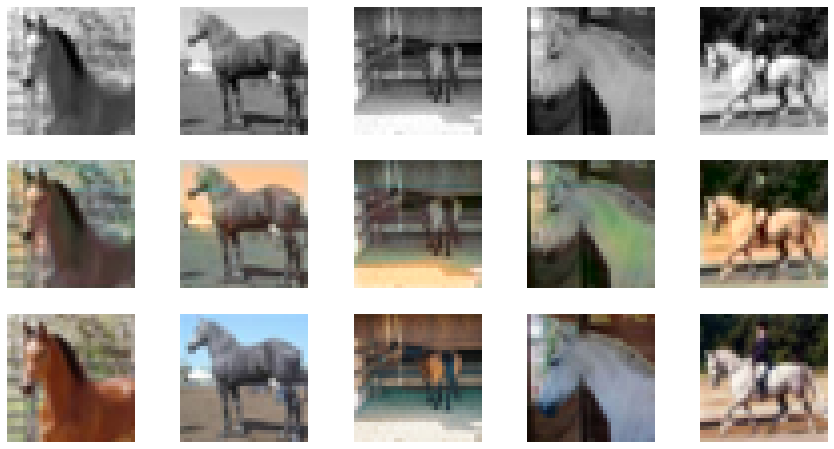

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 2/50
Iteration 200/313
loss_D_fake: 0.35226
loss_D_real: 0.36192
loss_D: 0.35709
loss_G_GAN: 2.19018
loss_G_L1: 9.38790
loss_G: 11.57808


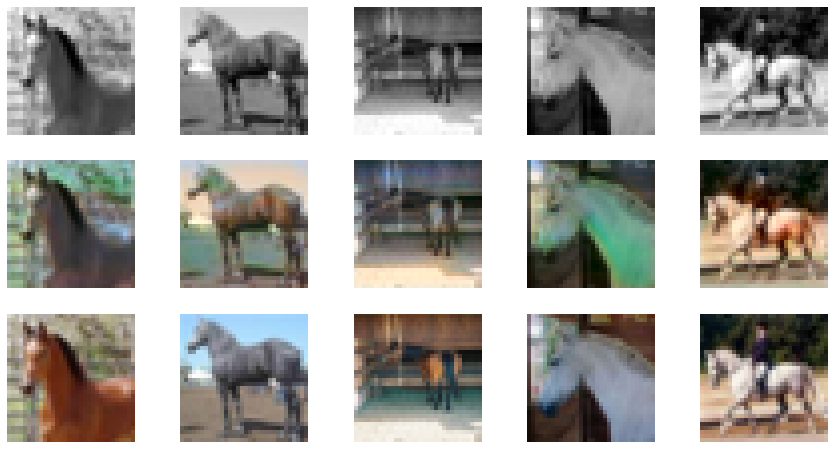

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 3/50
Iteration 200/313
loss_D_fake: 0.27926
loss_D_real: 0.28664
loss_D: 0.28295
loss_G_GAN: 2.62410
loss_G_L1: 9.63417
loss_G: 12.25827


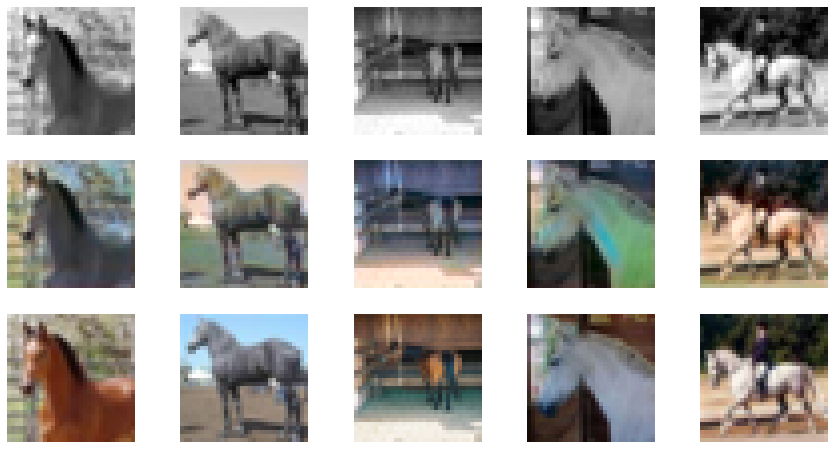

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 4/50
Iteration 200/313
loss_D_fake: 0.22169
loss_D_real: 0.21625
loss_D: 0.21897
loss_G_GAN: 3.05660
loss_G_L1: 9.72785
loss_G: 12.78445


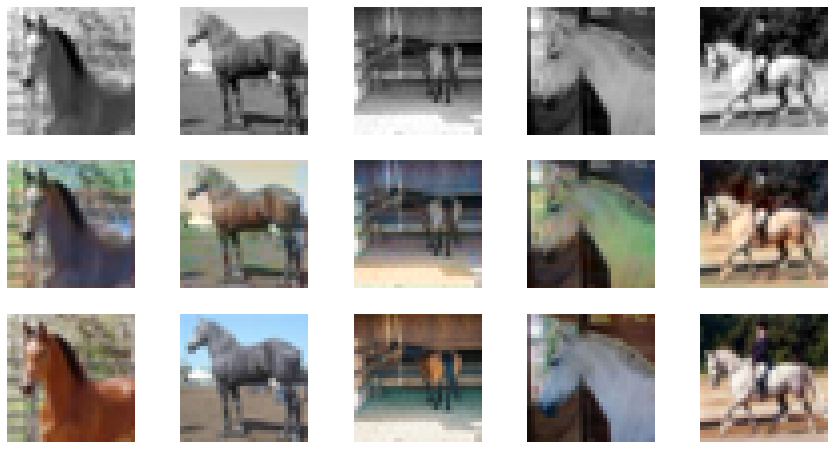

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 5/50
Iteration 200/313
loss_D_fake: 0.24879
loss_D_real: 0.22653
loss_D: 0.23766
loss_G_GAN: 3.30935
loss_G_L1: 9.69509
loss_G: 13.00443


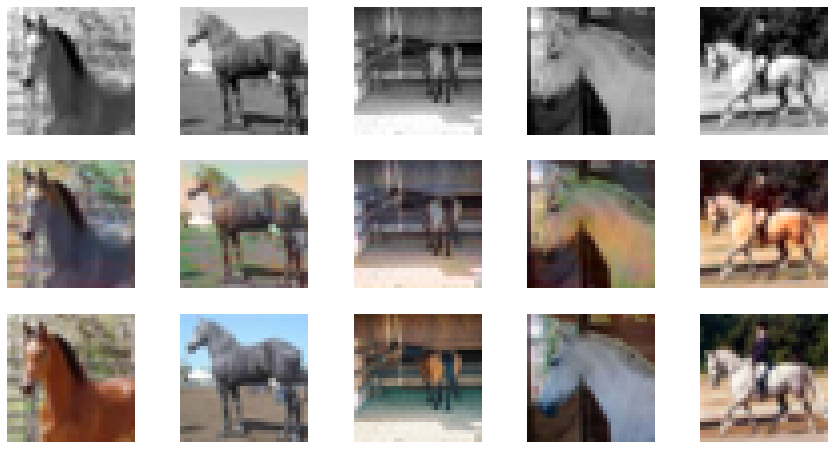

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 6/50
Iteration 200/313
loss_D_fake: 0.21862
loss_D_real: 0.21482
loss_D: 0.21672
loss_G_GAN: 3.44144
loss_G_L1: 9.52816
loss_G: 12.96960


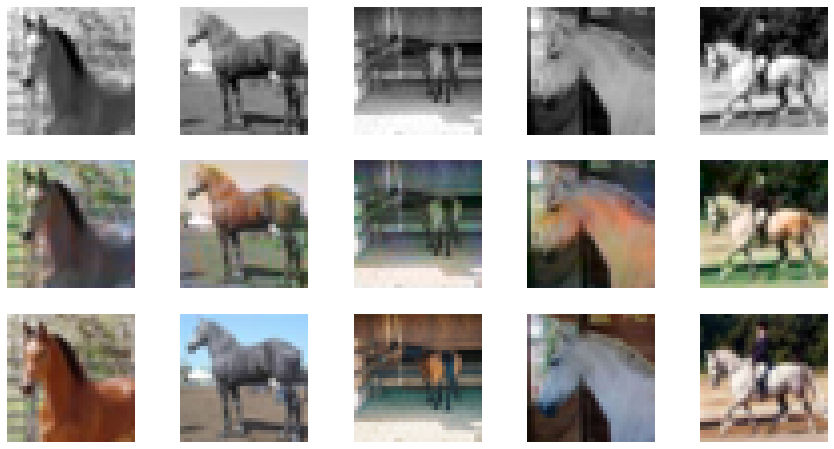

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 7/50
Iteration 200/313
loss_D_fake: 0.17755
loss_D_real: 0.18160
loss_D: 0.17957
loss_G_GAN: 3.78590
loss_G_L1: 9.66206
loss_G: 13.44796


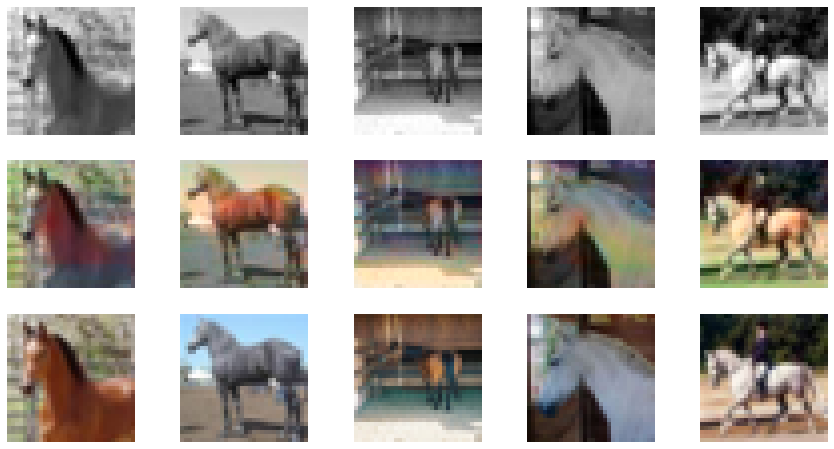

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 8/50
Iteration 200/313
loss_D_fake: 0.17660
loss_D_real: 0.16567
loss_D: 0.17113
loss_G_GAN: 4.02598
loss_G_L1: 9.70380
loss_G: 13.72978


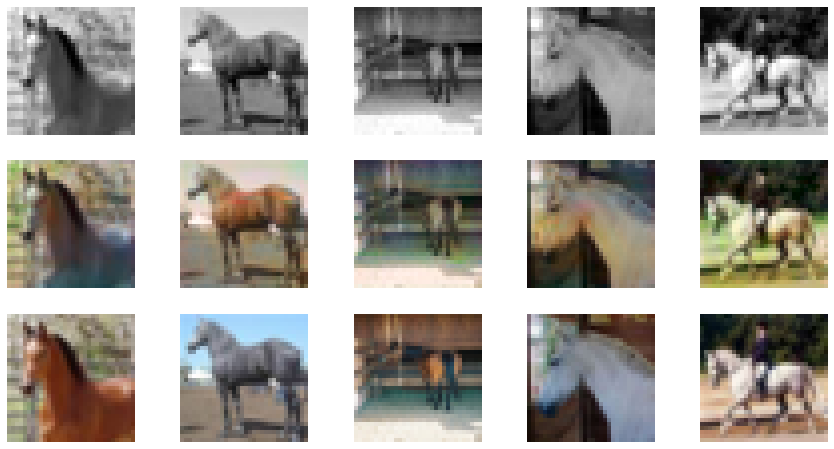

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 9/50
Iteration 200/313
loss_D_fake: 0.19020
loss_D_real: 0.16897
loss_D: 0.17958
loss_G_GAN: 4.01321
loss_G_L1: 9.70550
loss_G: 13.71871


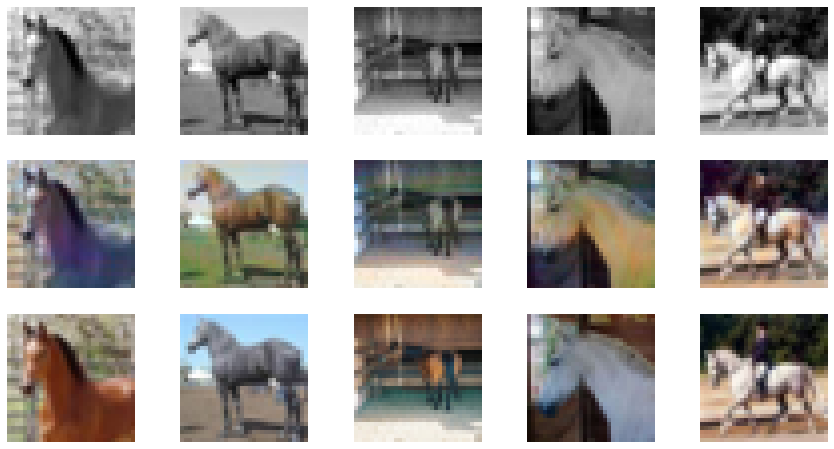

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 10/50
Iteration 200/313
loss_D_fake: 0.10666
loss_D_real: 0.10444
loss_D: 0.10555
loss_G_GAN: 4.42656
loss_G_L1: 9.92943
loss_G: 14.35599


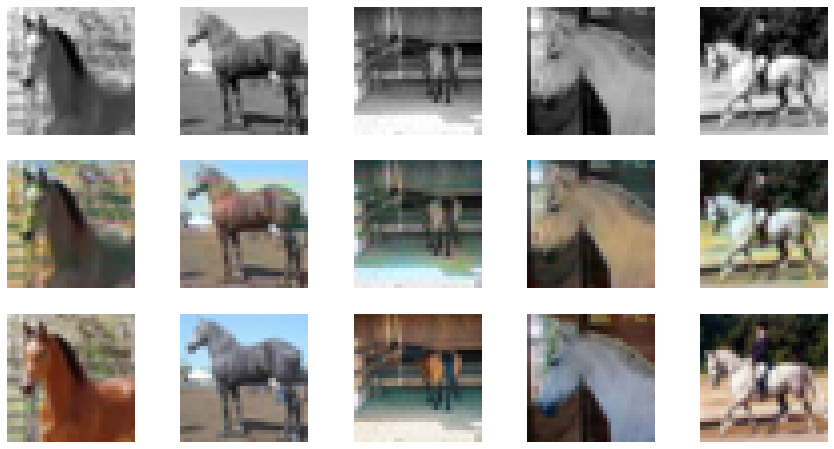

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 11/50
Iteration 200/313
loss_D_fake: 0.06920
loss_D_real: 0.06483
loss_D: 0.06701
loss_G_GAN: 5.00882
loss_G_L1: 9.87402
loss_G: 14.88284


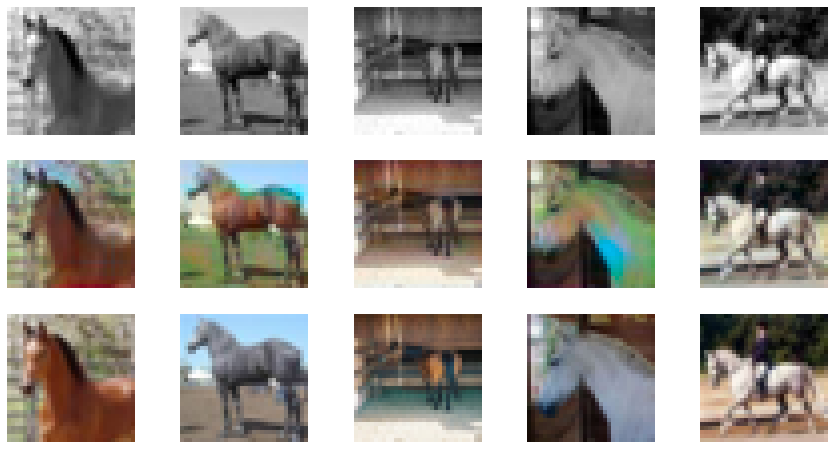

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 12/50
Iteration 200/313
loss_D_fake: 0.11765
loss_D_real: 0.10971
loss_D: 0.11368
loss_G_GAN: 5.07326
loss_G_L1: 9.78134
loss_G: 14.85460


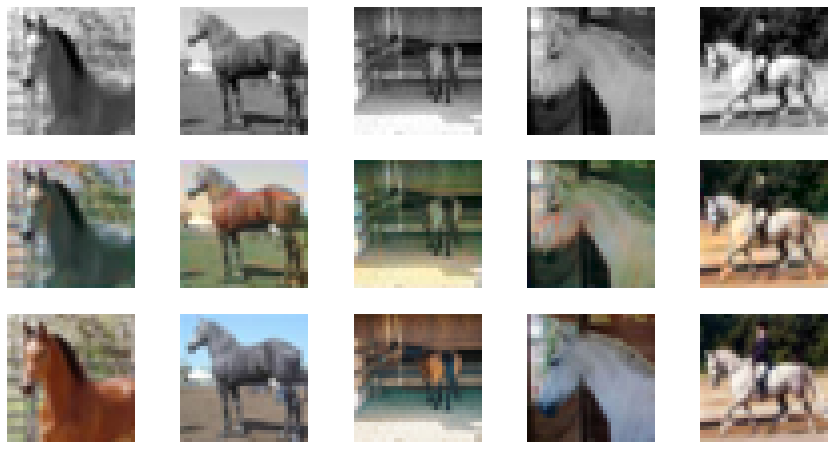

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 13/50
Iteration 200/313
loss_D_fake: 0.12333
loss_D_real: 0.10733
loss_D: 0.11533
loss_G_GAN: 4.89784
loss_G_L1: 9.60979
loss_G: 14.50764


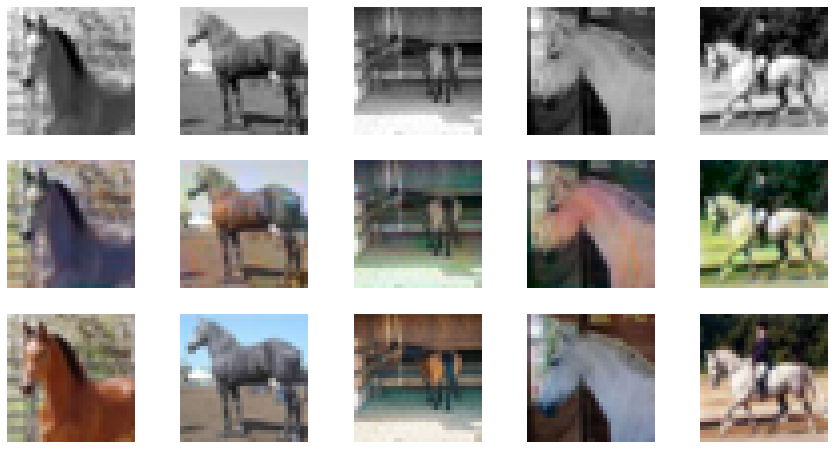

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 14/50
Iteration 200/313
loss_D_fake: 0.10599
loss_D_real: 0.09939
loss_D: 0.10269
loss_G_GAN: 5.24976
loss_G_L1: 9.89712
loss_G: 15.14688


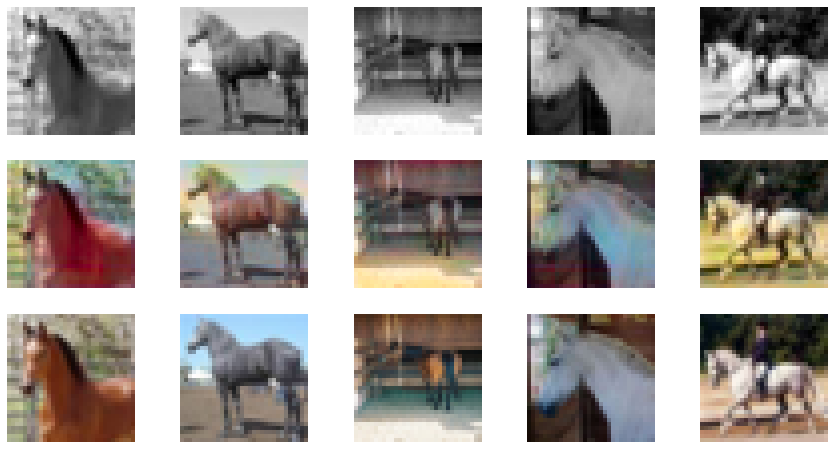

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 15/50
Iteration 200/313
loss_D_fake: 0.09027
loss_D_real: 0.09039
loss_D: 0.09033
loss_G_GAN: 5.41442
loss_G_L1: 9.52989
loss_G: 14.94431


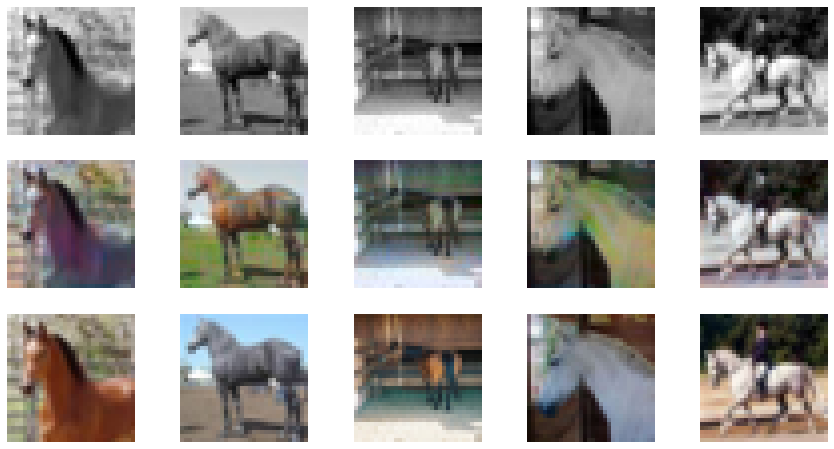

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 16/50
Iteration 200/313
loss_D_fake: 0.12986
loss_D_real: 0.11274
loss_D: 0.12130
loss_G_GAN: 5.36757
loss_G_L1: 9.71095
loss_G: 15.07852


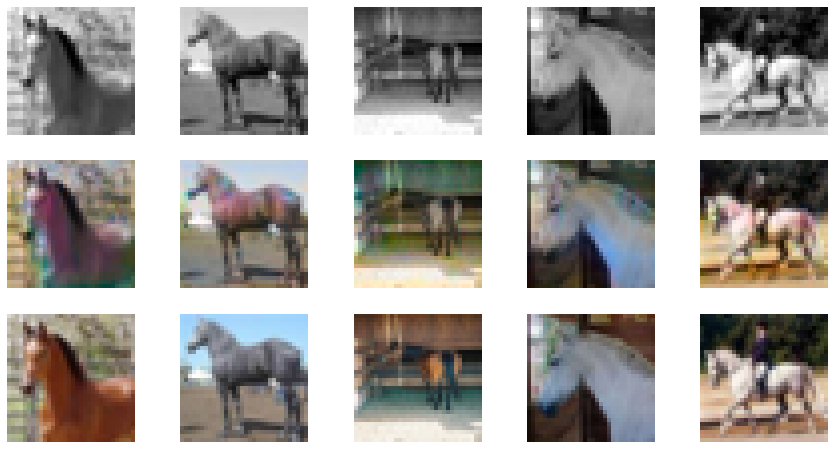

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 17/50
Iteration 200/313
loss_D_fake: 0.07082
loss_D_real: 0.06211
loss_D: 0.06647
loss_G_GAN: 5.87593
loss_G_L1: 9.59998
loss_G: 15.47591


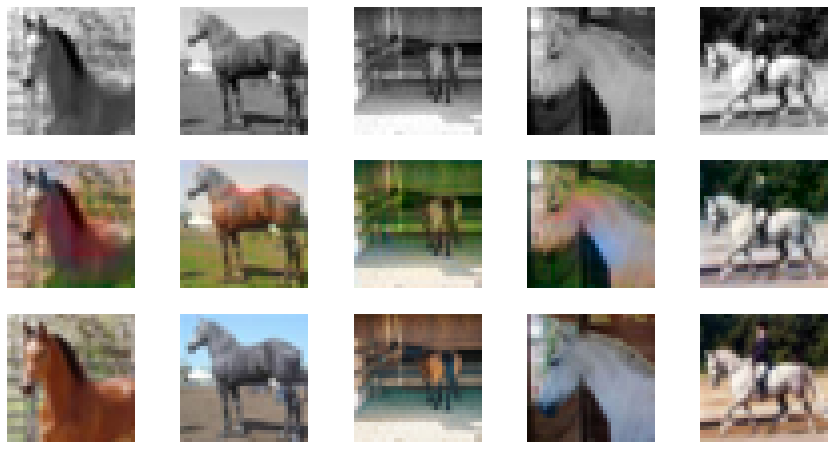

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 18/50
Iteration 200/313
loss_D_fake: 0.12676
loss_D_real: 0.11152
loss_D: 0.11914
loss_G_GAN: 5.49145
loss_G_L1: 9.67594
loss_G: 15.16739


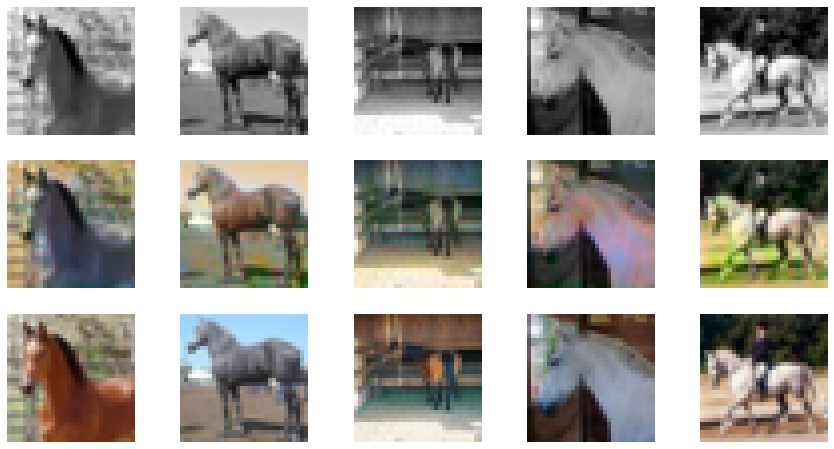

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 19/50
Iteration 200/313
loss_D_fake: 0.11807
loss_D_real: 0.09953
loss_D: 0.10880
loss_G_GAN: 5.34646
loss_G_L1: 9.38673
loss_G: 14.73319


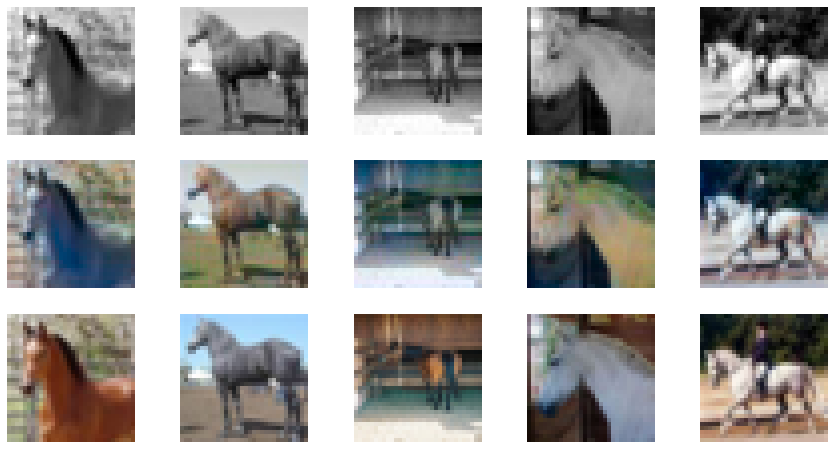

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 20/50
Iteration 200/313
loss_D_fake: 0.08512
loss_D_real: 0.09413
loss_D: 0.08962
loss_G_GAN: 5.57255
loss_G_L1: 9.66260
loss_G: 15.23515


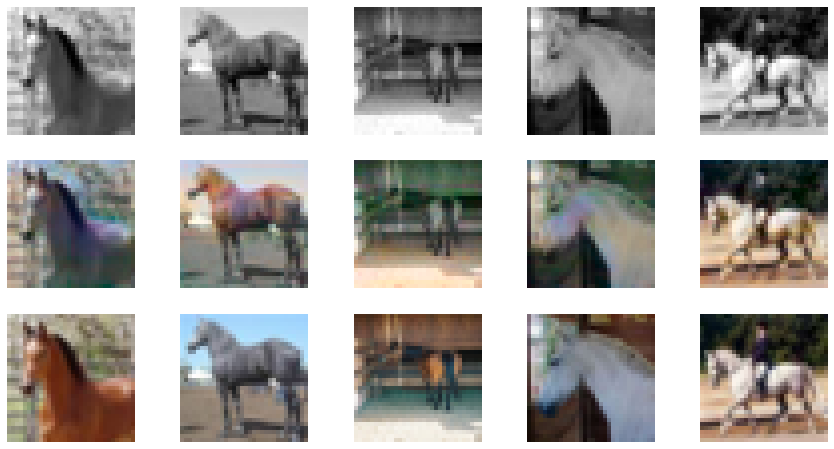

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 21/50
Iteration 200/313
loss_D_fake: 0.04031
loss_D_real: 0.04248
loss_D: 0.04140
loss_G_GAN: 5.88662
loss_G_L1: 9.74137
loss_G: 15.62798


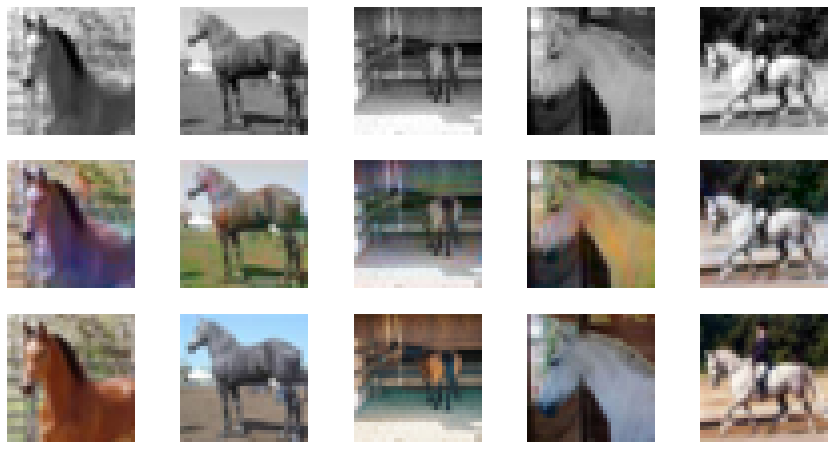

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 22/50
Iteration 200/313
loss_D_fake: 0.07774
loss_D_real: 0.07241
loss_D: 0.07507
loss_G_GAN: 5.85935
loss_G_L1: 9.73751
loss_G: 15.59686


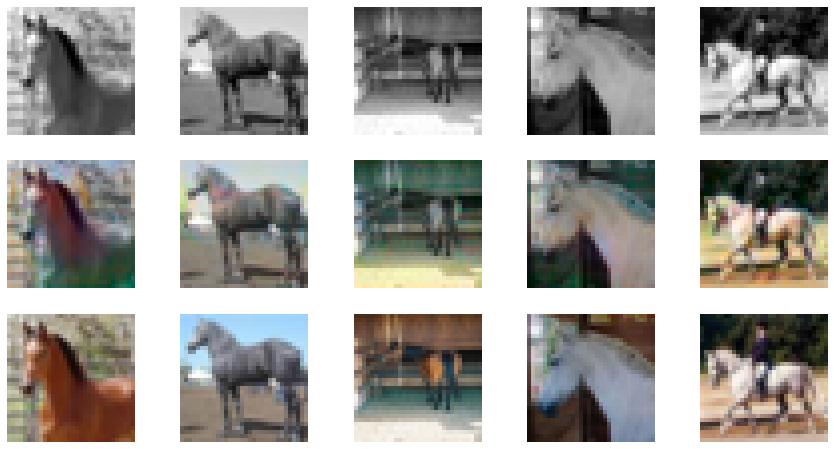

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 23/50
Iteration 200/313
loss_D_fake: 0.09551
loss_D_real: 0.08112
loss_D: 0.08831
loss_G_GAN: 6.17176
loss_G_L1: 9.58426
loss_G: 15.75602


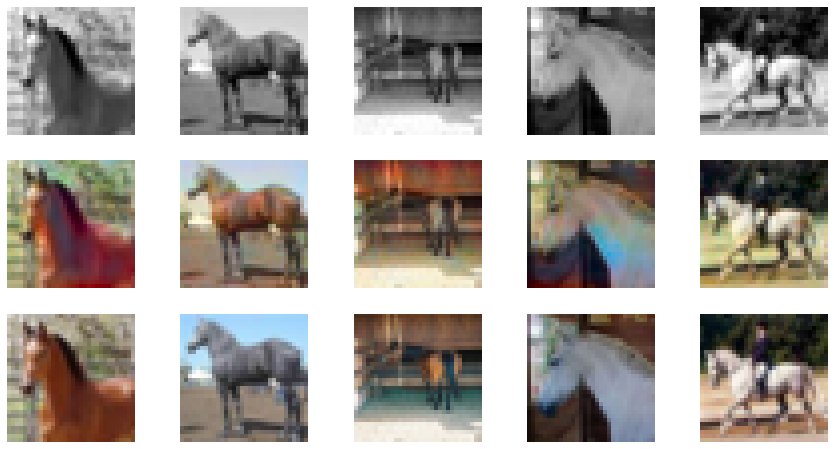

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 24/50
Iteration 200/313
loss_D_fake: 0.10341
loss_D_real: 0.10724
loss_D: 0.10532
loss_G_GAN: 5.83340
loss_G_L1: 9.54131
loss_G: 15.37471


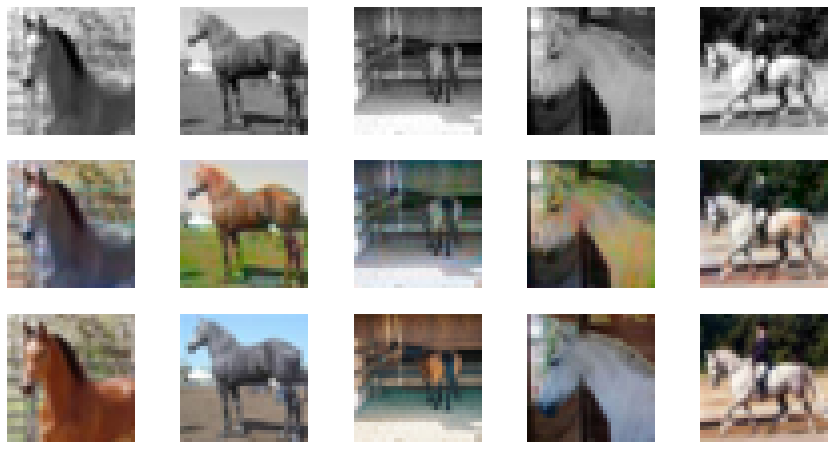

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 25/50
Iteration 200/313
loss_D_fake: 0.05513
loss_D_real: 0.05276
loss_D: 0.05395
loss_G_GAN: 6.21507
loss_G_L1: 9.58554
loss_G: 15.80060


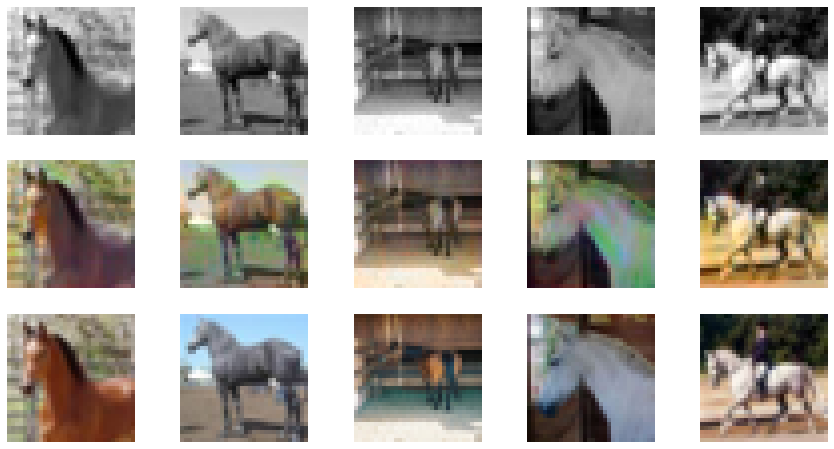

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 26/50
Iteration 200/313
loss_D_fake: 0.08865
loss_D_real: 0.07973
loss_D: 0.08419
loss_G_GAN: 5.91779
loss_G_L1: 9.46388
loss_G: 15.38167


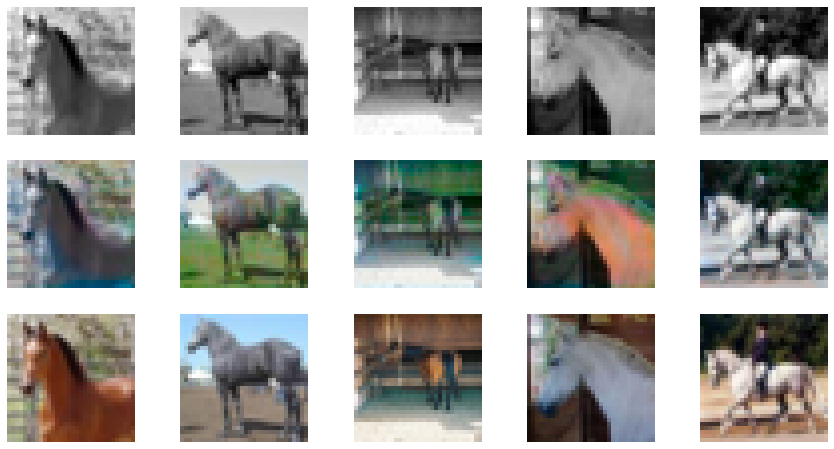

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 27/50
Iteration 200/313
loss_D_fake: 0.09322
loss_D_real: 0.08582
loss_D: 0.08952
loss_G_GAN: 6.20187
loss_G_L1: 9.53861
loss_G: 15.74047


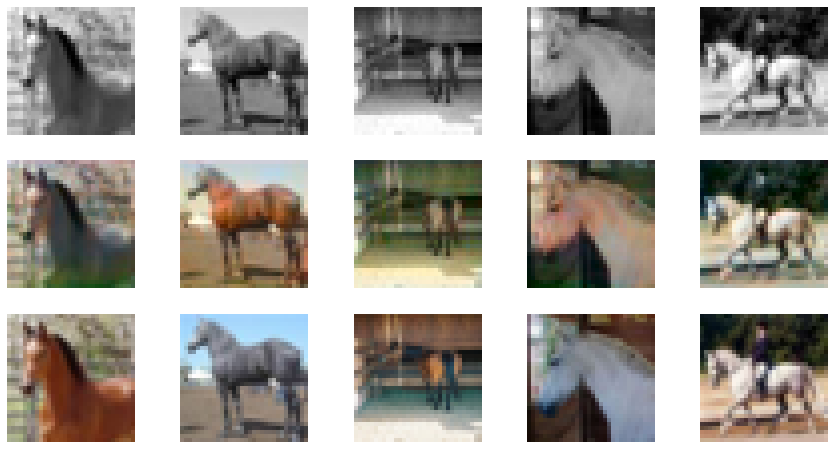

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 28/50
Iteration 200/313
loss_D_fake: 0.04409
loss_D_real: 0.04196
loss_D: 0.04302
loss_G_GAN: 6.72264
loss_G_L1: 9.58070
loss_G: 16.30334


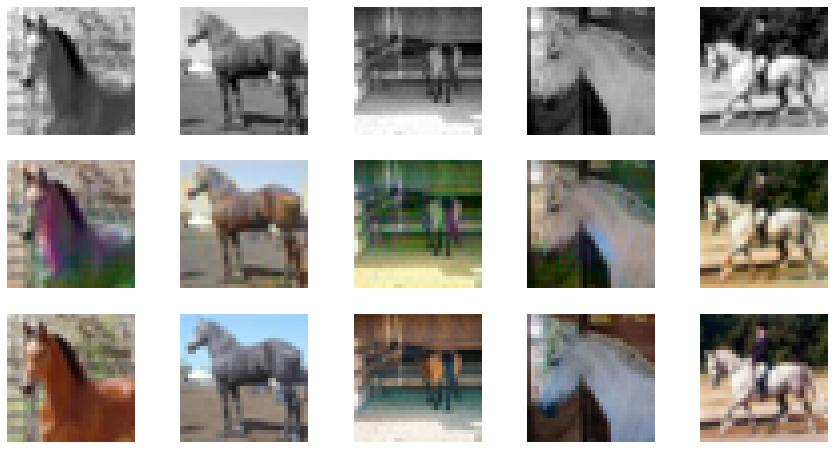

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 29/50
Iteration 200/313
loss_D_fake: 0.05153
loss_D_real: 0.04837
loss_D: 0.04995
loss_G_GAN: 6.44216
loss_G_L1: 9.43462
loss_G: 15.87678


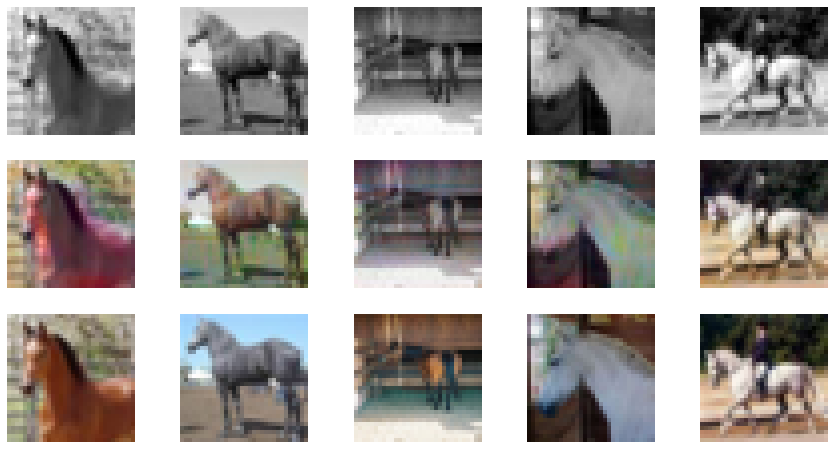

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 30/50
Iteration 200/313
loss_D_fake: 0.08028
loss_D_real: 0.08900
loss_D: 0.08464
loss_G_GAN: 6.45077
loss_G_L1: 9.67761
loss_G: 16.12838


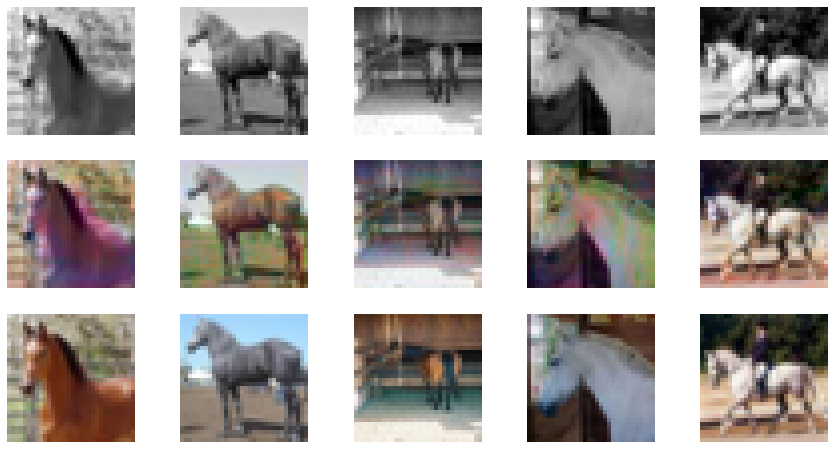

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 31/50
Iteration 200/313
loss_D_fake: 0.10355
loss_D_real: 0.09670
loss_D: 0.10013
loss_G_GAN: 6.00558
loss_G_L1: 9.37332
loss_G: 15.37890


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 8 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 2 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


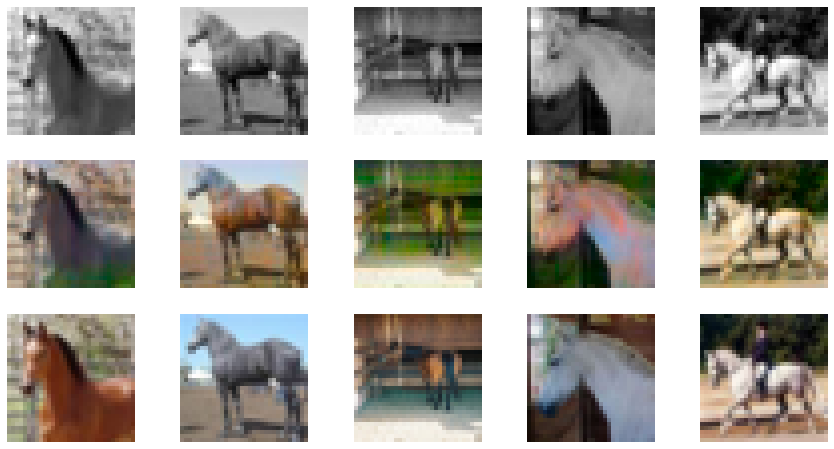

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 32/50
Iteration 200/313
loss_D_fake: 0.07375
loss_D_real: 0.06893
loss_D: 0.07134
loss_G_GAN: 6.18353
loss_G_L1: 9.56404
loss_G: 15.74756


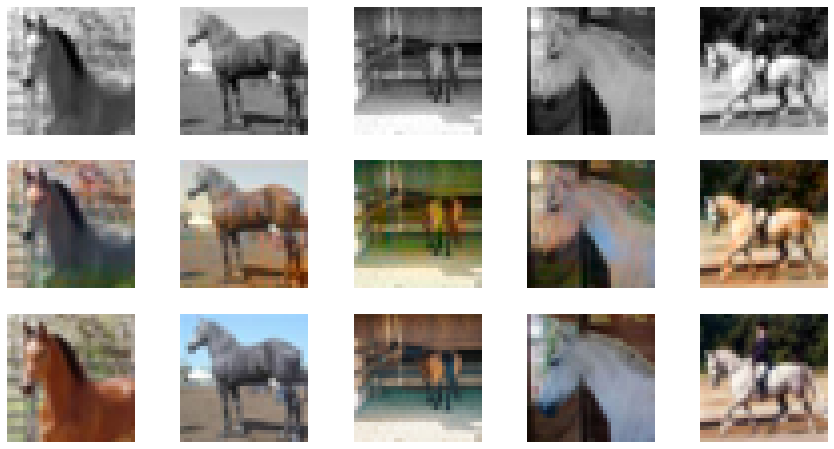

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 33/50
Iteration 200/313
loss_D_fake: 0.06510
loss_D_real: 0.06089
loss_D: 0.06299
loss_G_GAN: 6.23828
loss_G_L1: 9.64640
loss_G: 15.88467


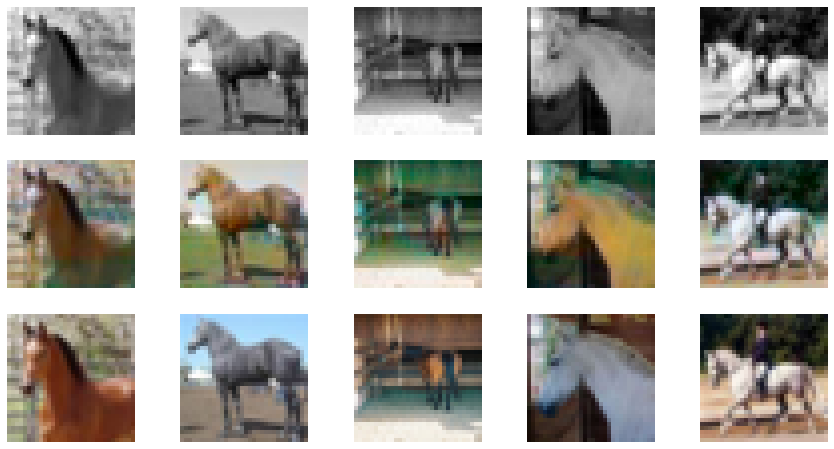

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 34/50
Iteration 200/313
loss_D_fake: 0.08022
loss_D_real: 0.07589
loss_D: 0.07806
loss_G_GAN: 6.24604
loss_G_L1: 9.59081
loss_G: 15.83685


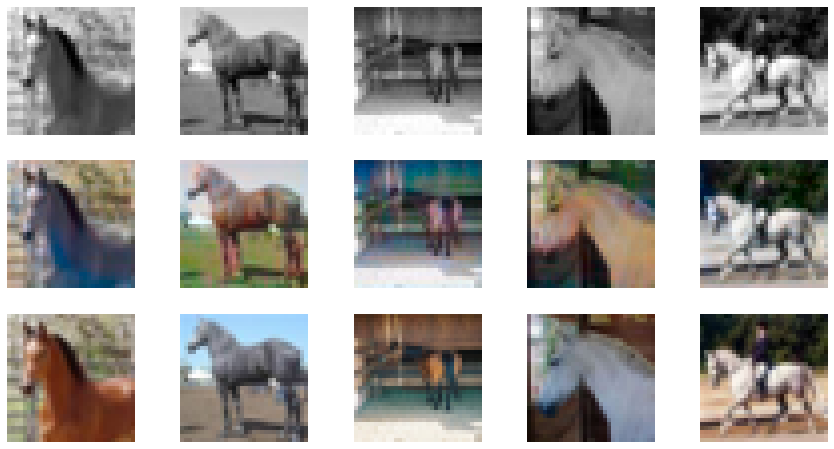

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 35/50
Iteration 200/313
loss_D_fake: 0.05290
loss_D_real: 0.05193
loss_D: 0.05242
loss_G_GAN: 6.44921
loss_G_L1: 9.57740
loss_G: 16.02661


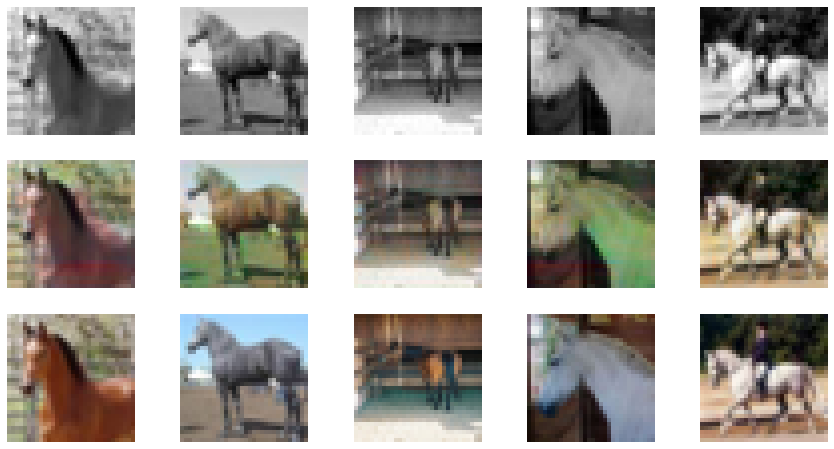

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 36/50
Iteration 200/313
loss_D_fake: 0.04380
loss_D_real: 0.04416
loss_D: 0.04398
loss_G_GAN: 6.82635
loss_G_L1: 9.61132
loss_G: 16.43767


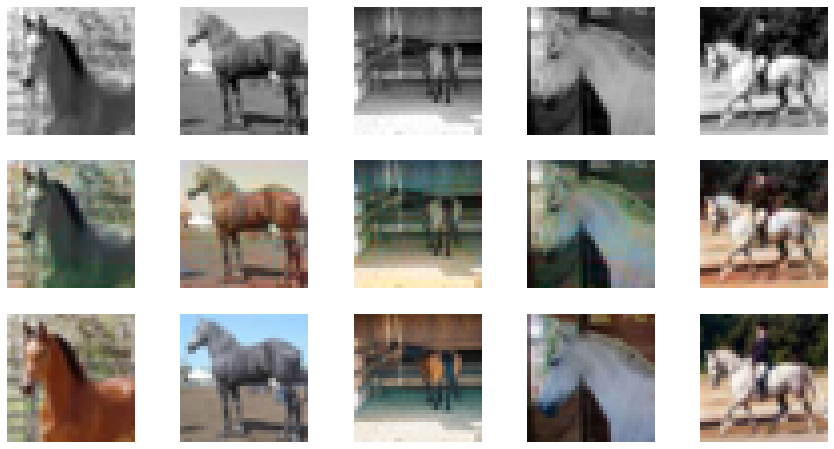

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 37/50
Iteration 200/313
loss_D_fake: 0.07553
loss_D_real: 0.07263
loss_D: 0.07408
loss_G_GAN: 6.73109
loss_G_L1: 9.42444
loss_G: 16.15553


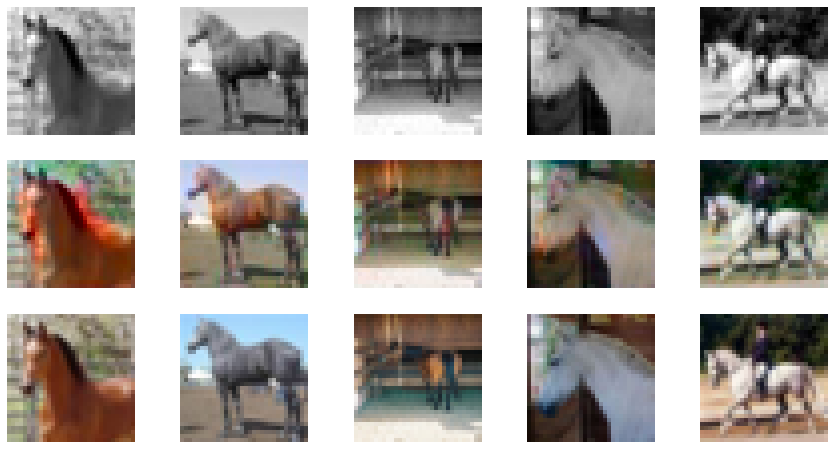

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 38/50
Iteration 200/313
loss_D_fake: 0.06168
loss_D_real: 0.05984
loss_D: 0.06076
loss_G_GAN: 6.99825
loss_G_L1: 9.83529
loss_G: 16.83354


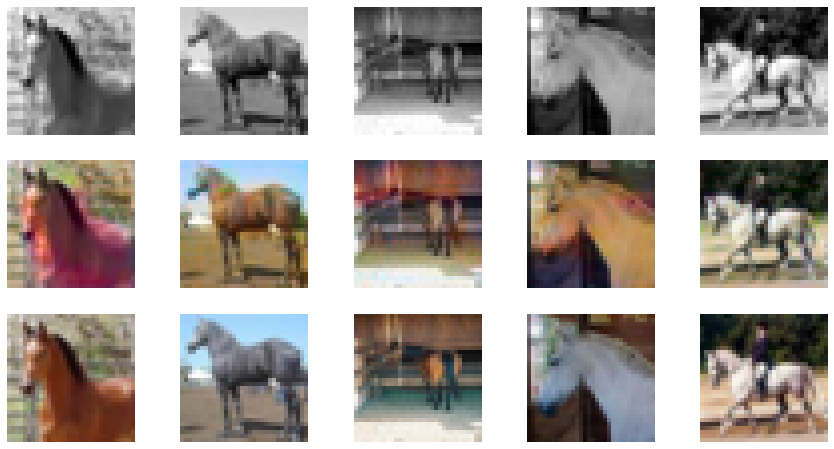

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 39/50
Iteration 200/313
loss_D_fake: 0.07296
loss_D_real: 0.08100
loss_D: 0.07698
loss_G_GAN: 6.57696
loss_G_L1: 9.25486
loss_G: 15.83181


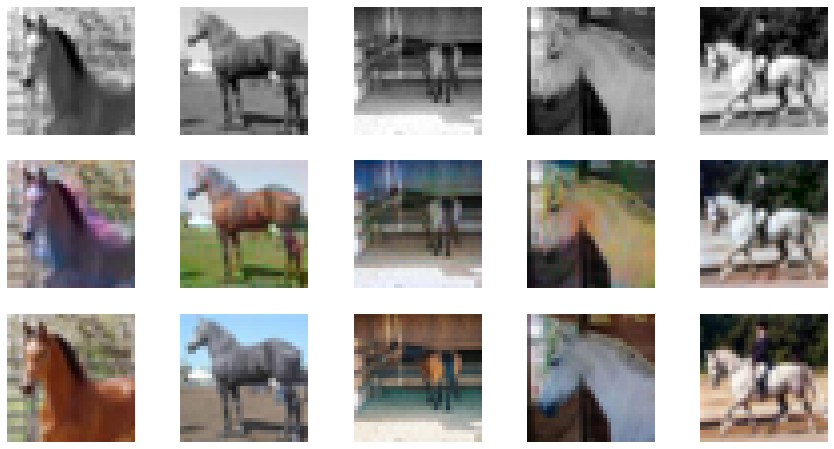

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 40/50
Iteration 200/313
loss_D_fake: 0.07943
loss_D_real: 0.07936
loss_D: 0.07939
loss_G_GAN: 6.76355
loss_G_L1: 9.59441
loss_G: 16.35796


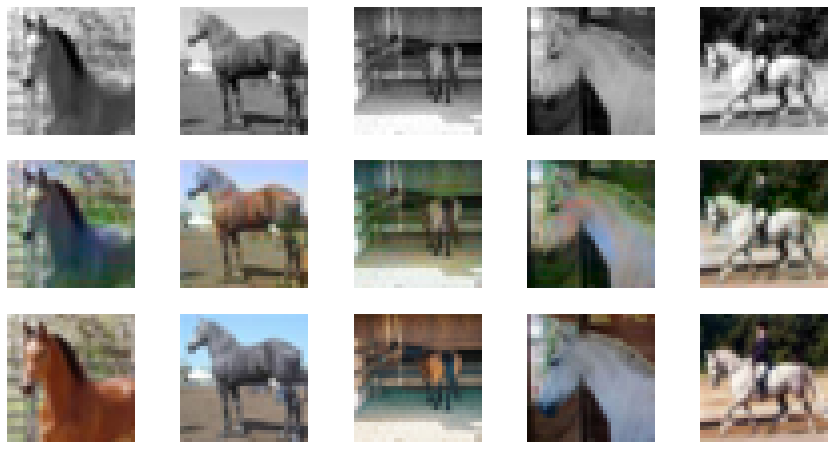

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 41/50
Iteration 200/313
loss_D_fake: 0.05046
loss_D_real: 0.04546
loss_D: 0.04796
loss_G_GAN: 7.28788
loss_G_L1: 9.29042
loss_G: 16.57829


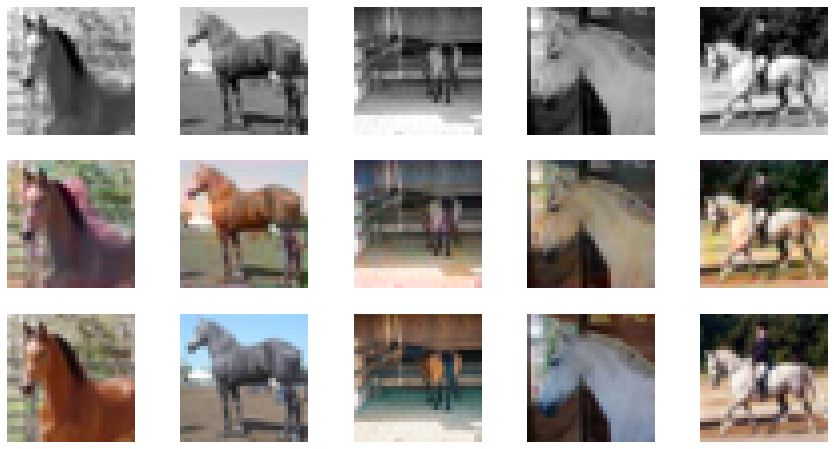

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 42/50
Iteration 200/313
loss_D_fake: 0.03439
loss_D_real: 0.03346
loss_D: 0.03393
loss_G_GAN: 6.66635
loss_G_L1: 9.63438
loss_G: 16.30074


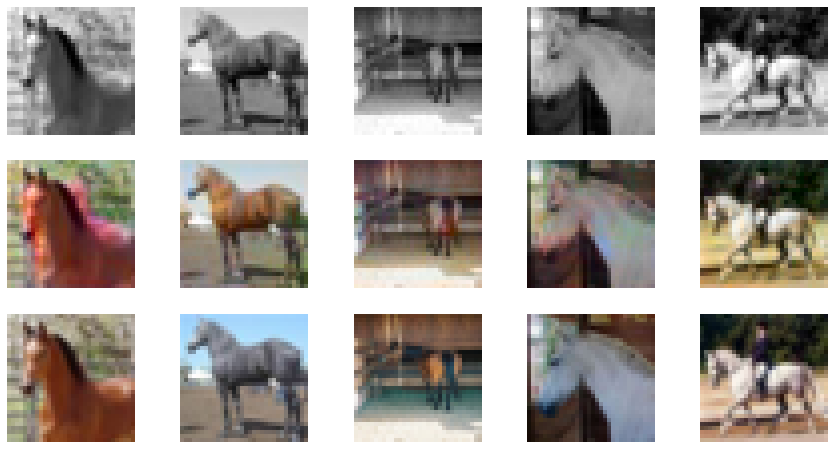

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 43/50
Iteration 200/313
loss_D_fake: 0.03106
loss_D_real: 0.03124
loss_D: 0.03115
loss_G_GAN: 6.90142
loss_G_L1: 9.78078
loss_G: 16.68220


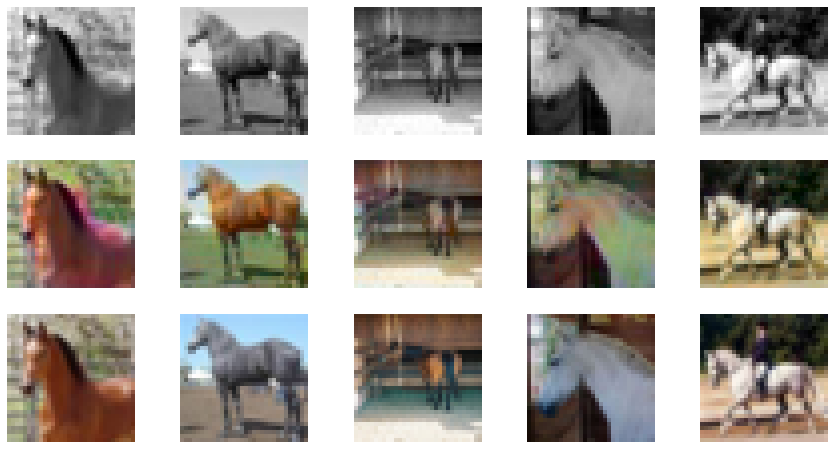

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 44/50
Iteration 200/313
loss_D_fake: 0.07797
loss_D_real: 0.06123
loss_D: 0.06960
loss_G_GAN: 7.00013
loss_G_L1: 9.51901
loss_G: 16.51914


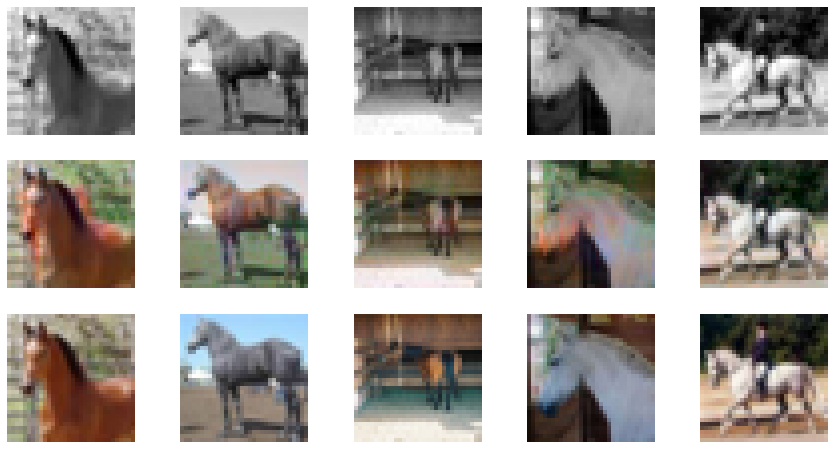

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 45/50
Iteration 200/313
loss_D_fake: 0.09914
loss_D_real: 0.08679
loss_D: 0.09296
loss_G_GAN: 6.58510
loss_G_L1: 9.43186
loss_G: 16.01696


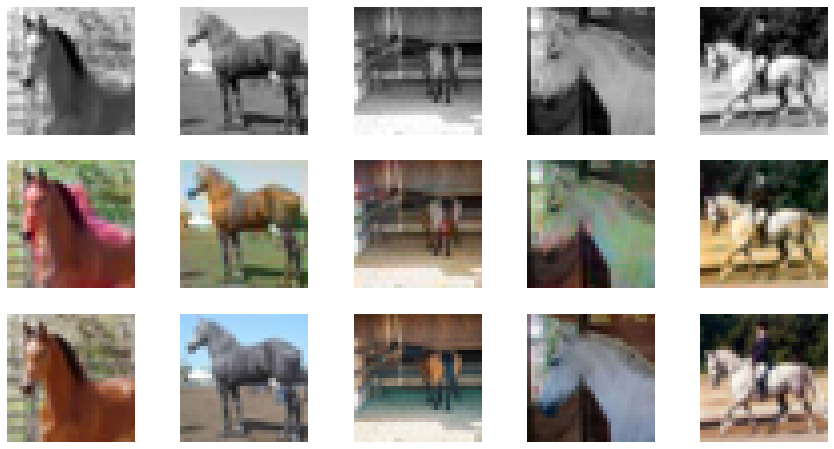

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 46/50
Iteration 200/313
loss_D_fake: 0.07575
loss_D_real: 0.07308
loss_D: 0.07441
loss_G_GAN: 6.47995
loss_G_L1: 9.58187
loss_G: 16.06181


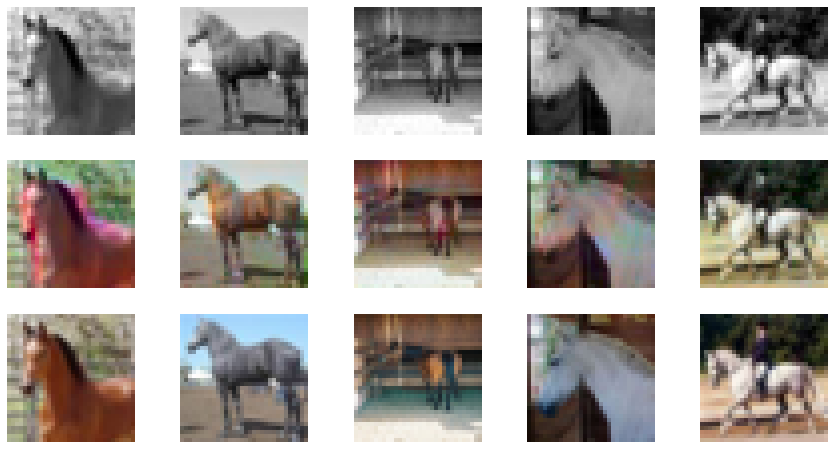

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 47/50
Iteration 200/313
loss_D_fake: 0.04684
loss_D_real: 0.04704
loss_D: 0.04694
loss_G_GAN: 6.31381
loss_G_L1: 9.62160
loss_G: 15.93541


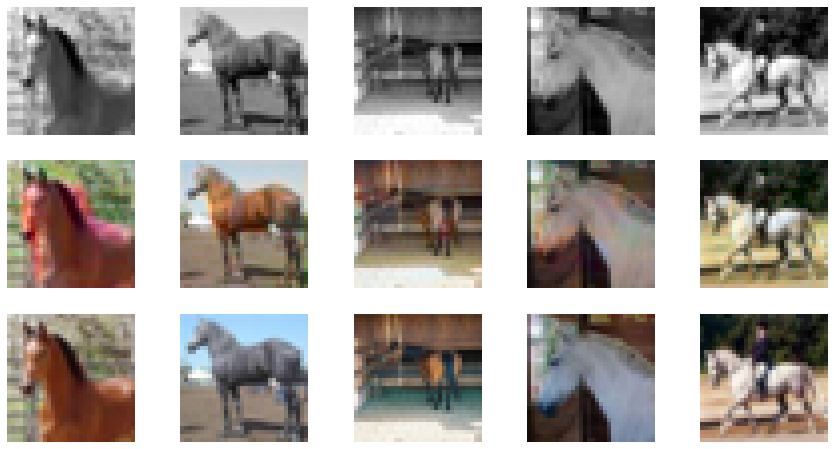

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 48/50
Iteration 200/313
loss_D_fake: 0.05526
loss_D_real: 0.05014
loss_D: 0.05270
loss_G_GAN: 6.31262
loss_G_L1: 9.58384
loss_G: 15.89646


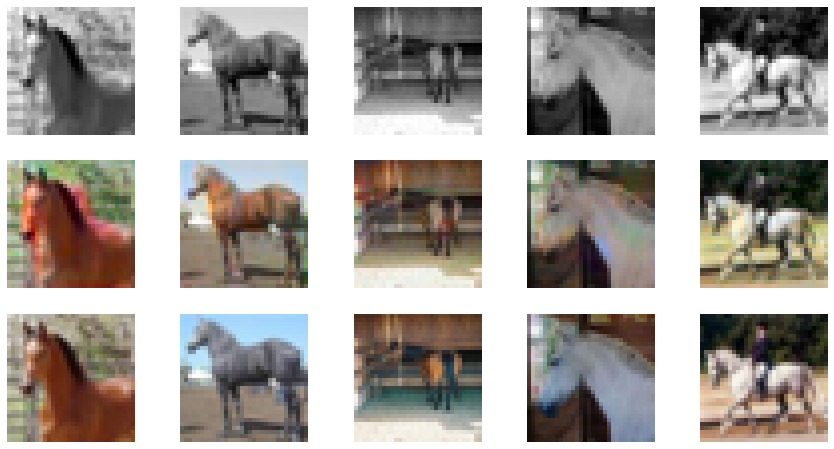

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 49/50
Iteration 200/313
loss_D_fake: 0.07250
loss_D_real: 0.06526
loss_D: 0.06888
loss_G_GAN: 6.56845
loss_G_L1: 9.53305
loss_G: 16.10150


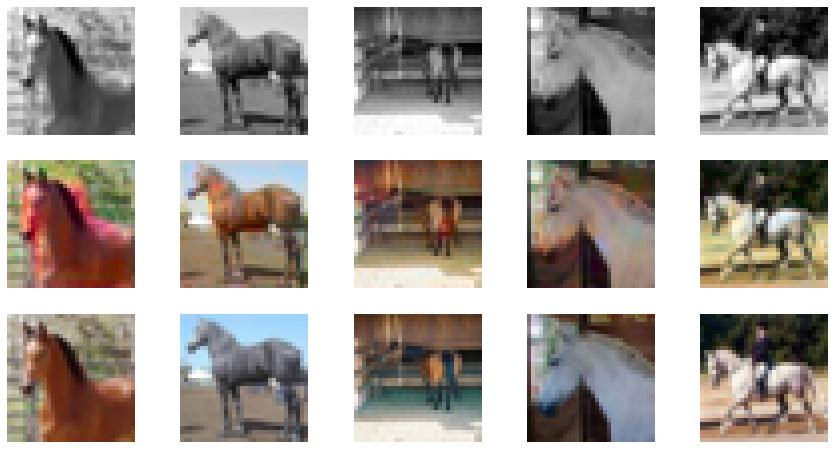

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 50/50
Iteration 200/313
loss_D_fake: 0.05946
loss_D_real: 0.05850
loss_D: 0.05898
loss_G_GAN: 6.58126
loss_G_L1: 9.66628
loss_G: 16.24754


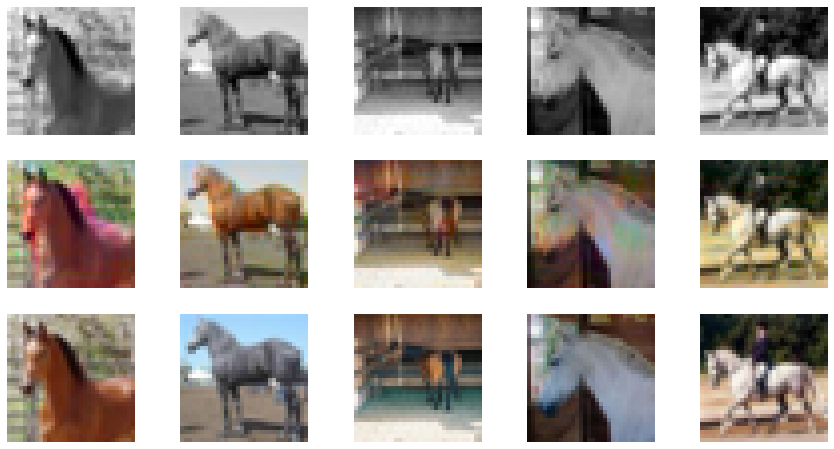

In [ ]:
# Traning the model with cifar train set images

def train_model(model, train_dl, epochs, display_every=200):
    data = next(iter(val_dl)) # getting a batch for visualizing the model output after fixed intrvals
    for e in range(epochs):
        loss_meter_dict = create_loss_meters() # function returing a dictionary of objects to 
        i = 0                                  # log the losses of the complete network
        for data in tqdm(train_dl):
            model.setup_input(data) 
            model.optimize()
            update_losses(model, loss_meter_dict, count=data['L'].size(0)) # function updating the log objects
            i += 1
            if i % display_every == 0:
                print(f"\nEpoch {e+1}/{epochs}")
                print(f"Iteration {i}/{len(train_dl)}")
                log_results(loss_meter_dict) # function to print out the losses
                visualize(model, data, save=False) # function displaying the model's outputs

model = MainModel()
train_model(model, train_dl, 50)

**Note** : The image in the middle is the fake image produced by the generator and the last row is the original image.

I trained up untill 50 epochs since the performance reached is resonable (produced good output colored images except the first red horse image), also because if trained for more epoch it would take longer and colab might get disconnected. I think the performance can be improved drastically if we use higer resolution image, a larger dataset and greater number of epochs. However due to limitations of my local computer and colab I trained for only 50 epochs.

Save th trained model weights to my google drive

In [ ]:
# Save th trained model weights to my google drive
# Mount to drive to load the model
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
# Save the model to Google drive
model_save_name = 'final_model_weights2.pt'
path = F"/content/gdrive/My Drive/MIE1517/Lab3/{model_save_name}" 
torch.save(model.state_dict(), path)

In [ ]:
# Load the model from Google drive
model_save_name = 'final_model_weights2.pt'
path = F"/content/gdrive/My Drive/MIE1517/Lab3/{model_save_name}"
model.load_state_dict(torch.load(path))

<All keys matched successfully>

## Part 3. New Data [5 pt]
Retrieve sample pictures from online and demonstrate how well your best model performs. Provide all your code.

**Answer**

To obtain new online dataset I used the **tiny_imagenet** data set which is a smaller version of image net dataset. To download the dataset i used code from the follwing refernce. 

**Reference**: The follwing code to load the images was obtained from this github repo: https://github.com/AliaksandrSiarohin/wc-gan/blob/master/tiny_imagenet.py

In [ ]:
#Reference: The follwing code to load the images was obtained from this github repo: https://github.com/AliaksandrSiarohin/wc-gan/blob/master/tiny_imagenet.py

from keras.utils.data_utils import get_file
import os
import numpy as np
from skimage.transform import resize
from skimage import img_as_ubyte
from tqdm import tqdm
from skimage.io import imread
from skimage.color import gray2rgb
import pickle


def load_data():
    """Loads tiny-imagenet dataset.
    # Returns
        Tuple of Numpy arrays: `(x_train, y_train), (x_test, y_test)`.
    # Raises
        ValueError: in case of invalid `label_mode`.
    """

#    dirname = 'tiny-imagenet-200' 
    origin = 'http://cs231n.stanford.edu/tiny-imagenet-200.zip'
    path = get_file('tiny-imagenet-200.zip', origin=origin, extract=True, cache_dir='.', archive_format='zip')
    path = path.replace('.zip', '')

    def load_train_images():
        subdir = 'train'
        X = np.empty((500 * 200, 64, 64, 3), dtype='uint8')
        Y = np.empty((500 * 200, ), dtype='int')
        classes = []
        for cls in os.listdir(os.path.join(path, subdir)):
            classes.append(cls)
#        f = open('ti_classses.pkl', 'w')
#        pickle.dump(classes, f)
#        f.close()
        classes = {name: i for i, name in enumerate(classes)}     
        i = 0
        for cls in tqdm(os.listdir(os.path.join(path, subdir))):
            for img in os.listdir(os.path.join(path, subdir, cls, 'images')):
                name = os.path.join(path, subdir, cls, 'images', img)
                image = imread(name)
                if len(image.shape) == 2:
                    image = gray2rgb(image)
                X[i] = image
                Y[i] = classes[cls]
                i += 1
        print(i)
        return X, Y

    def load_test_images():
        X = np.empty((100 * (50 + 50), 64, 64, 3), dtype='uint8')
        Y = None
        i = 0
        for subdir in ('test', ):
            for img in tqdm(os.listdir(os.path.join(path, subdir, 'images'))):
                name = os.path.join(path, subdir, 'images', img)
                image = imread(name)
                if len(image.shape) == 2:
                    image = gray2rgb(image)
                X[i] = image
                i += 1
        print(i)
        return X, Y
    print ("Loading images...")
    X_train, Y_train = load_train_images()
    X_test, Y_test = load_test_images()

    return (X_train, Y_train), (X_test, Y_test)

This part of the code was implemented by me to convert the dataset into the correct format and then split it into grey and lab color space a,b layers so that the model can process the image. 

In [ ]:
(X_train, Y_train), (X_test, Y_test)= load_data()

Loading images...


100%|██████████| 200/200 [01:05<00:00,  3.06it/s]


100000


100%|██████████| 10000/10000 [00:09<00:00, 1046.59it/s]

10000


In [ ]:
print(X_test.shape)  

(10000, 64, 64, 3)


In [ ]:
#Need to tf.transpose(X_test, [0, 3, 1, 2]) to bring into NCHW format and then need to convert back to numpy
import tensorflow as tf
X_test_fixed=tf.transpose(X_test, [0, 3, 1, 2]).numpy()
print(X_test_fixed.shape) 

(10000, 3, 64, 64)


In [ ]:
# Take a small segment of X_test:
X_test_subset= X_test_fixed[0:1000,:,:,:]

In [ ]:
print(X_test_subset.shape) # This is out test RGB images

(1000, 3, 64, 64)



Modified process method so that it doesn't pick a specific class.

In [ ]:
# select a single category.

# convert colour images into greyscale
def process(xs, max_pixel=256.0, downsize_input=False):
    """
    Pre-process CIFAR10 images by taking only the horse category,
    shuffling, and have colour values be bound between 0 and 1

    Args:
      xs: the colour RGB pixel values
      ys: the category labels
      max_pixel: maximum pixel value in the original data
    Returns:
      xs: value normalized and shuffled colour images
      grey: greyscale images, also normalized so values are between 0 and 1
    """
    xs = xs / max_pixel
    npr.shuffle(xs)

    grey = np.mean(xs, axis=1, keepdims=True)

    if downsize_input:
        downsize_module = nn.Sequential(
            nn.AvgPool2d(2),
            nn.AvgPool2d(2),
            nn.Upsample(scale_factor=2),
            nn.Upsample(scale_factor=2),
        )
        xs_downsized = downsize_module.forward(torch.from_numpy(xs).float())
        xs_downsized = xs_downsized.data.numpy()
        return (xs, xs_downsized)
    else:
        return (xs, grey)

In [ ]:
test_rgb, test_grey = process(X_test_subset) # We only need x_test

test_paths = test_rgb
print(len(test_paths))

1000


In [ ]:
import numpy as numpy
SIZE = 256
class ColorizationDataset(Dataset):
    def __init__(self, paths, split='train'):
        if split == 'train':
            self.transforms = transforms.Compose([
                transforms.Resize((SIZE, SIZE),  Image.BICUBIC),
                transforms.RandomHorizontalFlip(), # A little data augmentation!
            ])
        elif split == 'val':
            self.transforms = transforms.Resize((SIZE, SIZE),  Image.BICUBIC)
        
        self.split = split
        self.size = SIZE
        self.paths = paths
    
    def __getitem__(self, idx):
        #img = self.paths[idx]
        #img = self.transforms(img)
        img = np.array(self.paths[idx])
        img = numpy.transpose(img, (1, 2, 0))
        img_lab = rgb2lab(img).astype("float32") # Converting RGB to L*a*b
        img_lab = transforms.ToTensor()(img_lab)
        L = img_lab[[0], ...] / 50. - 1. # Between -1 and 1
        ab = img_lab[[1, 2], ...] / 110. # Between -1 and 1
        
        return {'L': L, 'ab': ab}
    
    def __len__(self):
        return len(self.paths)

def make_dataloaders(batch_size=16, n_workers=4, pin_memory=True, **kwargs): # A handy function to make our dataloaders
    dataset = ColorizationDataset(**kwargs)
    dataloader = DataLoader(dataset, batch_size=batch_size, num_workers=n_workers,
                            pin_memory=pin_memory)
    return dataloader

In [ ]:
test_dl = make_dataloaders(paths=test_paths, split='val')

data = next(iter(test_dl))
Ls, abs_ = data['L'], data['ab']
print(Ls.shape, abs_.shape)
print(len(test_dl))


torch.Size([16, 1, 64, 64]) torch.Size([16, 2, 64, 64])
63


Now we pass our test images to the model in model.eval mode and plot out the visualizations for 1000 images in the IMAGENETE

In [ ]:
# Mount to drive to load the model
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
# Load the model from Google drive
model_save_name = 'final_model_weights2.pt'
path = F"/content/gdrive/My Drive/MIE1517/Lab3/{model_save_name}"
model.load_state_dict(torch.load(path))

<All keys matched successfully>

  0%|          | 0/63 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 35 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 14 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 10 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 25 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 11 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color

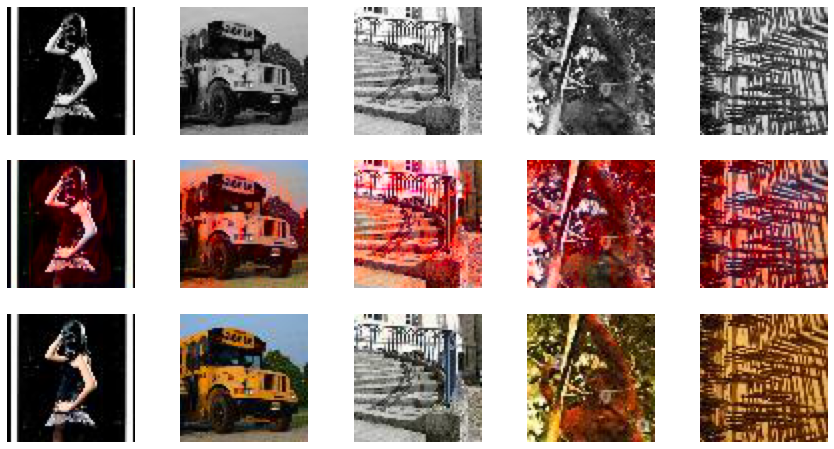

  2%|▏         | 1/63 [00:02<02:37,  2.54s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 55 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 6 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 87 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 24 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 4 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage

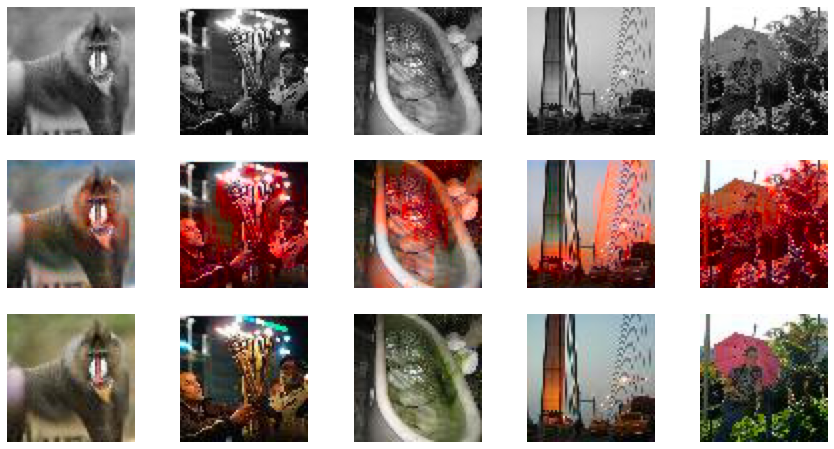

  3%|▎         | 2/63 [00:03<01:44,  1.71s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 22 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 48 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 72 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 84 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 51 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skima

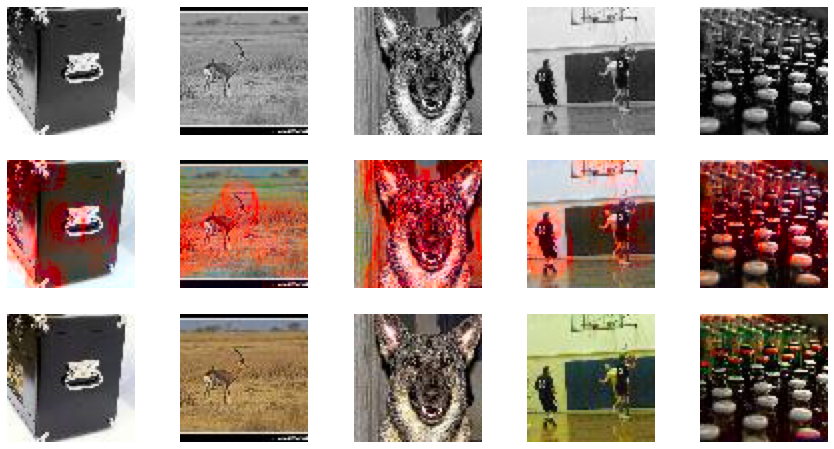

  5%|▍         | 3/63 [00:04<01:26,  1.43s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 294 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 45 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 74 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 31 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


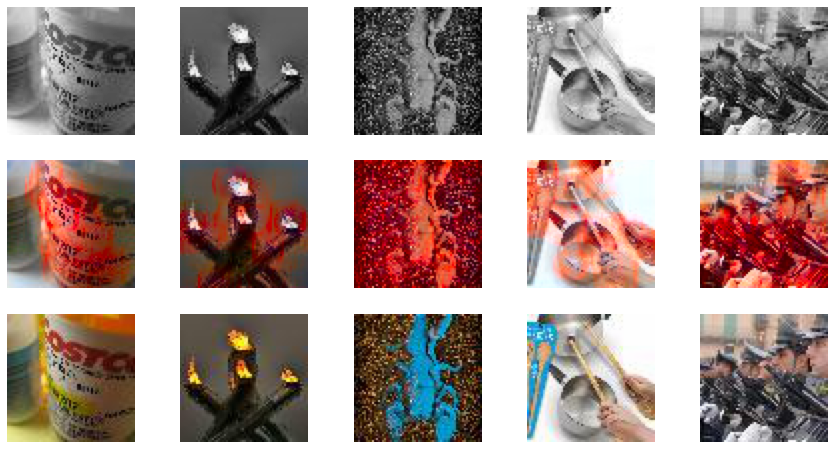

  6%|▋         | 4/63 [00:05<01:17,  1.32s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 49 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 20 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 54 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 37 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 26 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skima

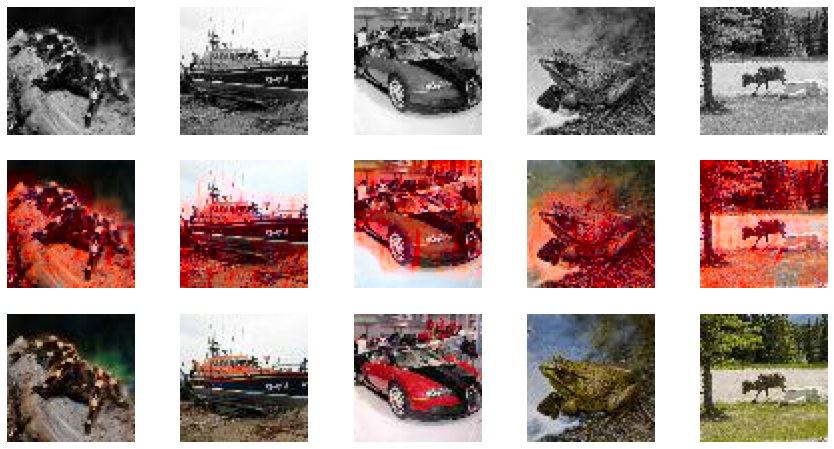

  8%|▊         | 5/63 [00:07<01:17,  1.33s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 34 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 39 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 111 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


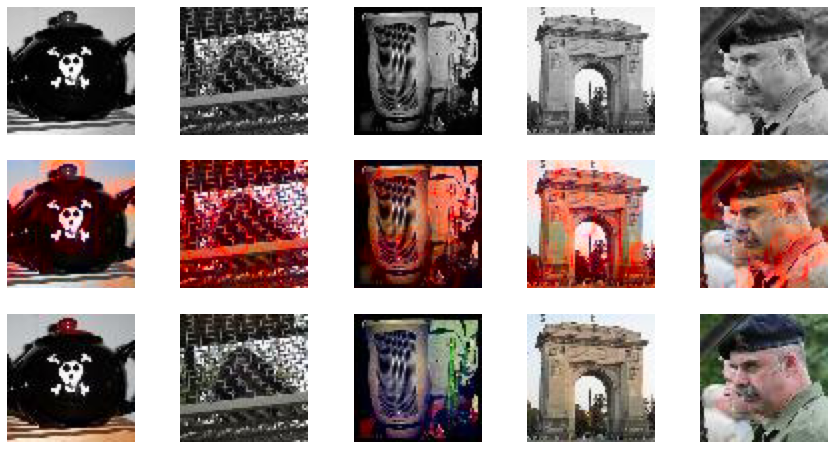

 10%|▉         | 6/63 [00:08<01:11,  1.25s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 13 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 73 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 23 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 75 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 86 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


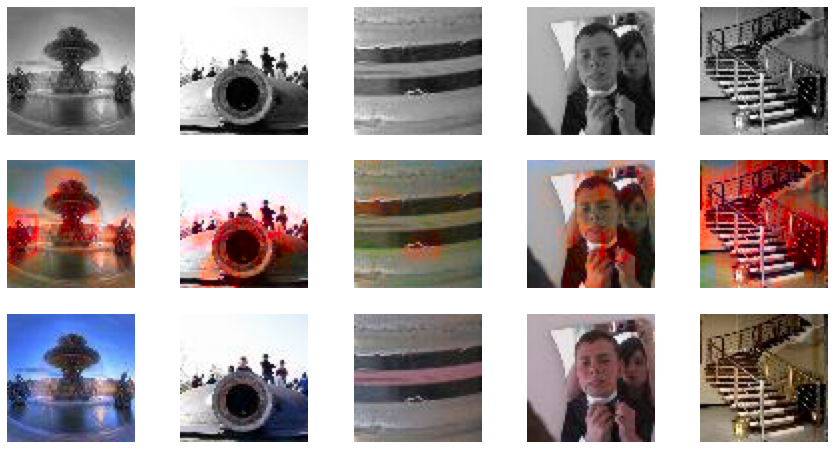

 11%|█         | 7/63 [00:09<01:06,  1.19s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 44 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 68 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 82 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


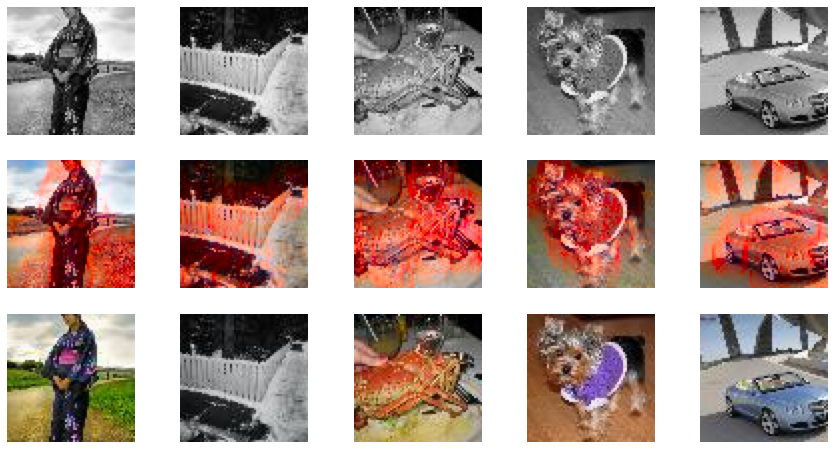

 13%|█▎        | 8/63 [00:10<01:03,  1.16s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 32 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


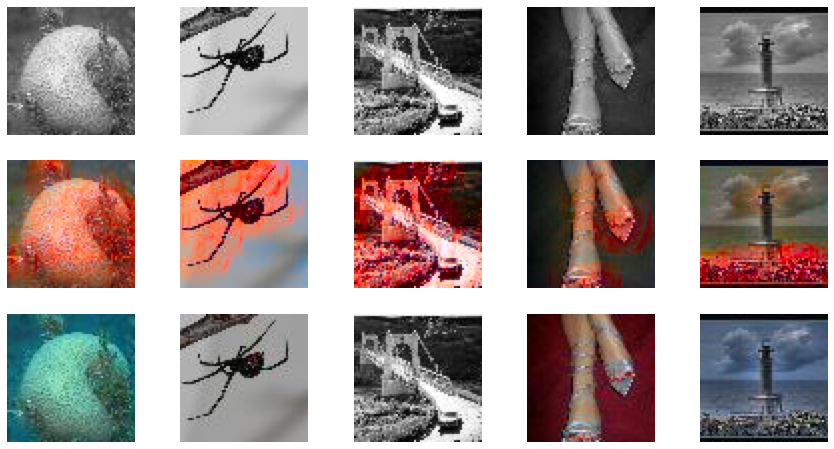

 14%|█▍        | 9/63 [00:11<01:05,  1.22s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 7 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 69 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


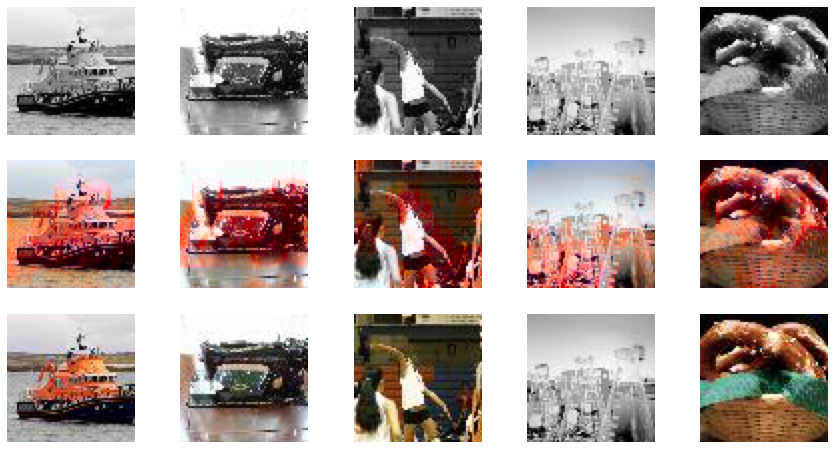

 16%|█▌        | 10/63 [00:12<01:02,  1.18s/it]

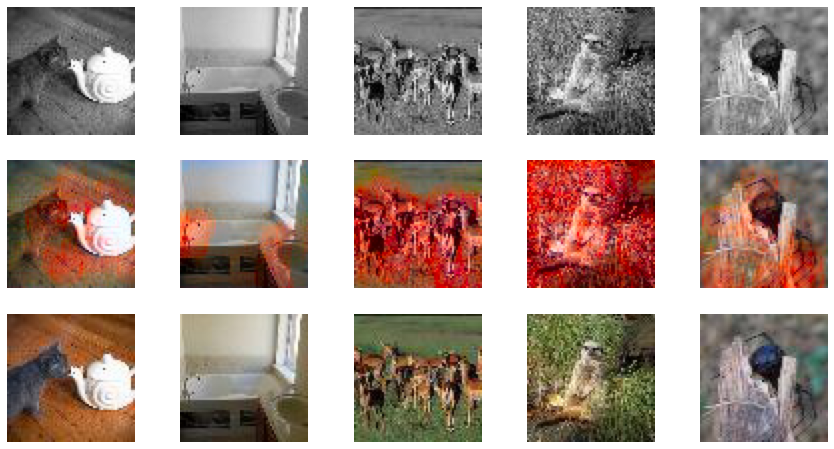

 17%|█▋        | 11/63 [00:14<00:59,  1.15s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 16 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 92 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


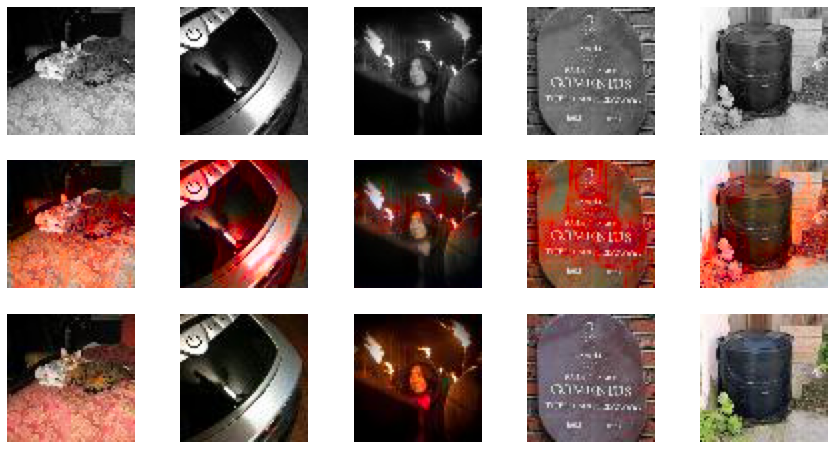

 19%|█▉        | 12/63 [00:15<00:58,  1.14s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 29 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 28 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


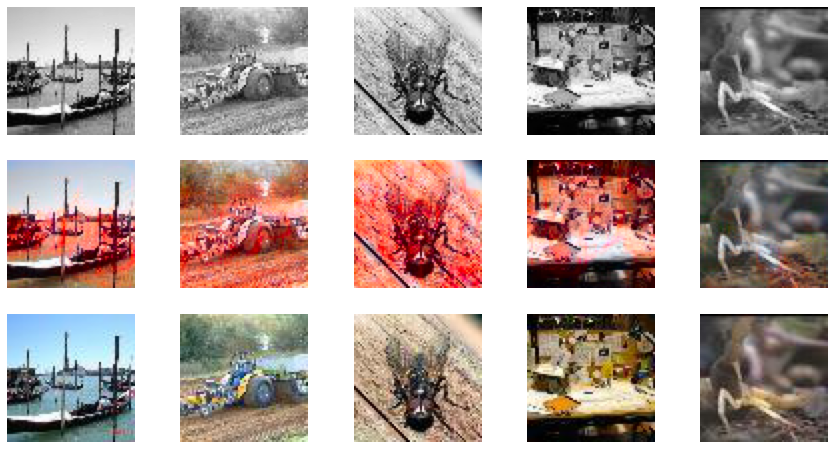

 21%|██        | 13/63 [00:16<01:00,  1.21s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 15 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 83 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


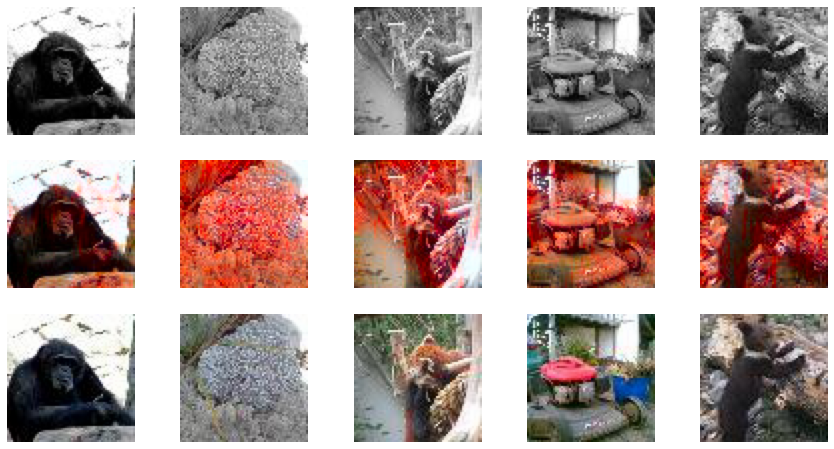

 22%|██▏       | 14/63 [00:17<00:57,  1.17s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 18 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 40 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 50 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 91 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


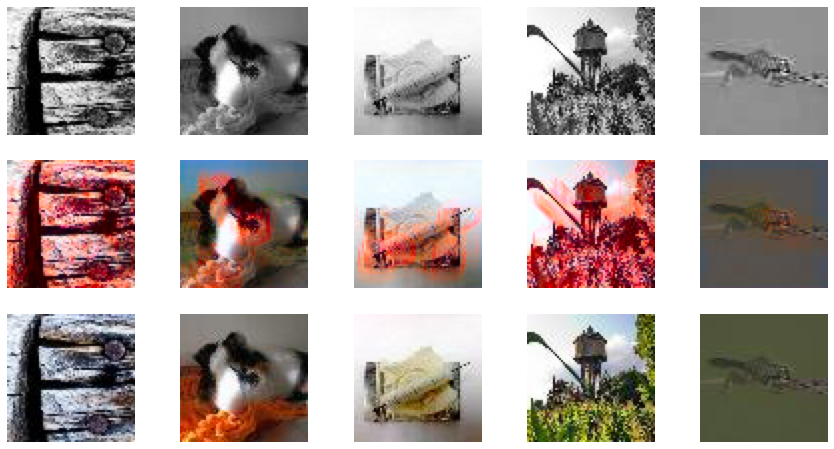

 24%|██▍       | 15/63 [00:18<00:54,  1.14s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 99 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


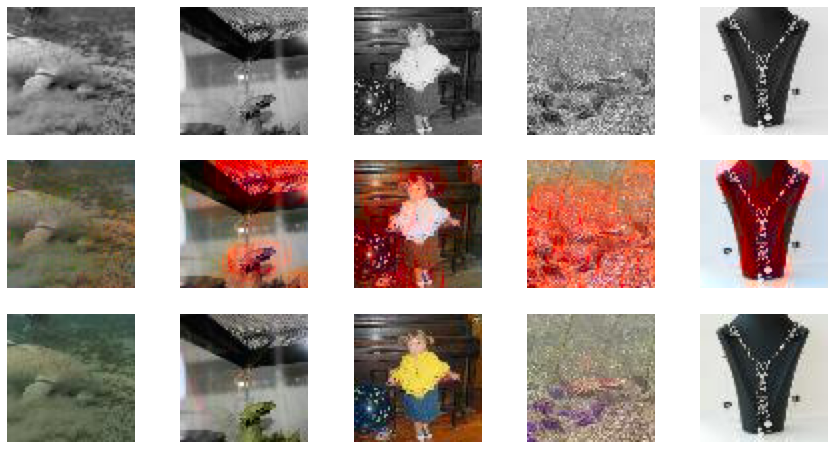

 25%|██▌       | 16/63 [00:19<00:52,  1.12s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 30 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


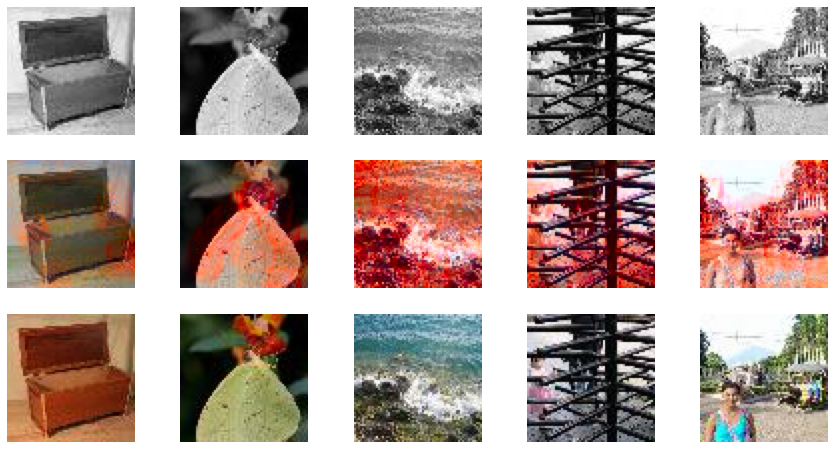

 27%|██▋       | 17/63 [00:20<00:51,  1.13s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 81 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 52 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 53 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


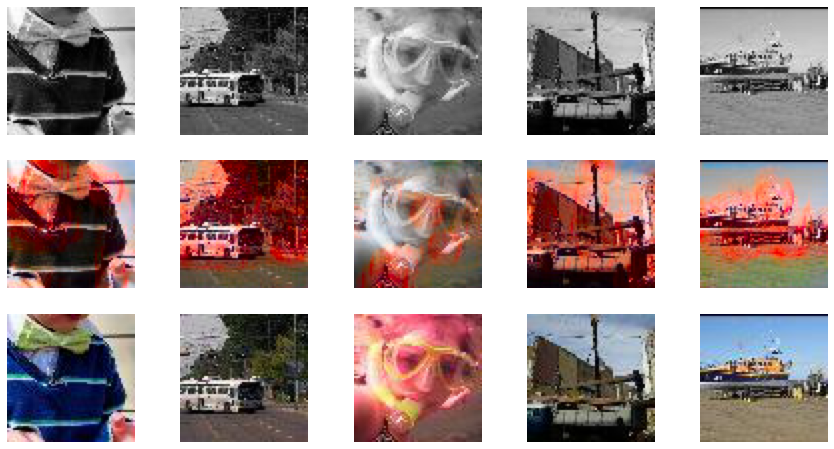

 29%|██▊       | 18/63 [00:22<00:54,  1.21s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 59 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 65 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


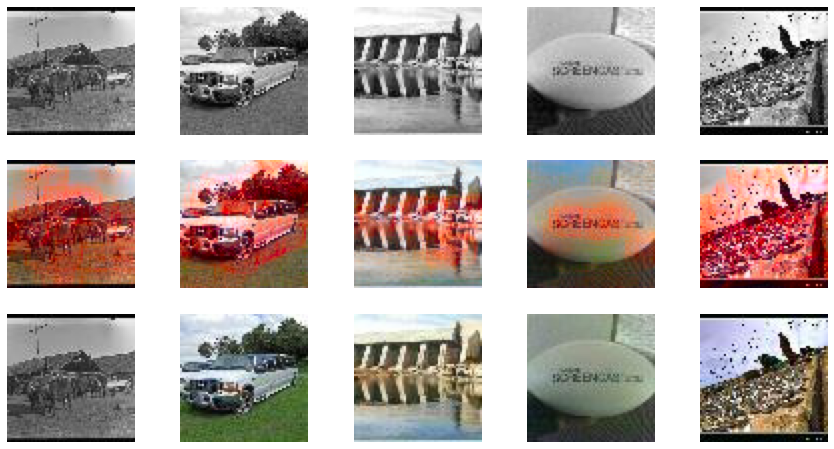

 30%|███       | 19/63 [00:23<00:52,  1.19s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 96 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 71 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


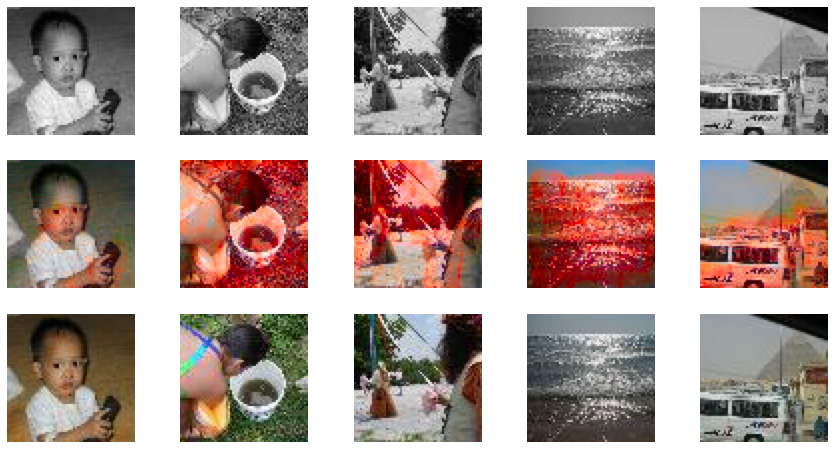

 32%|███▏      | 20/63 [00:24<00:50,  1.17s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 38 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 27 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 47 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 58 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


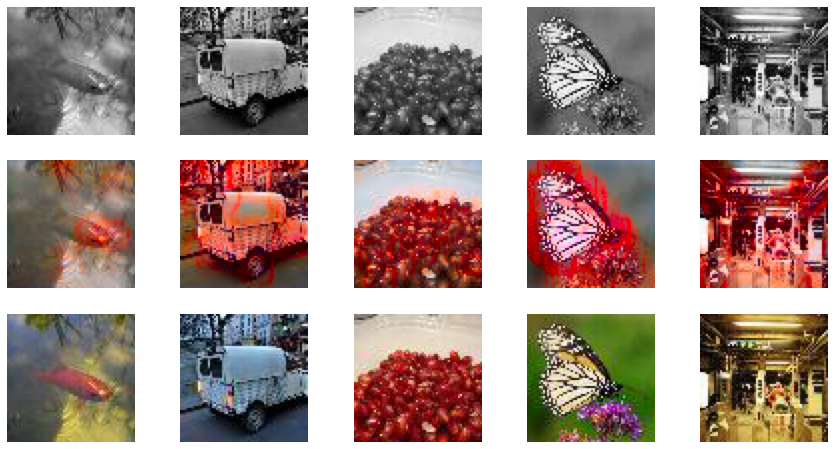

 33%|███▎      | 21/63 [00:25<00:48,  1.16s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 141 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 113 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 60 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


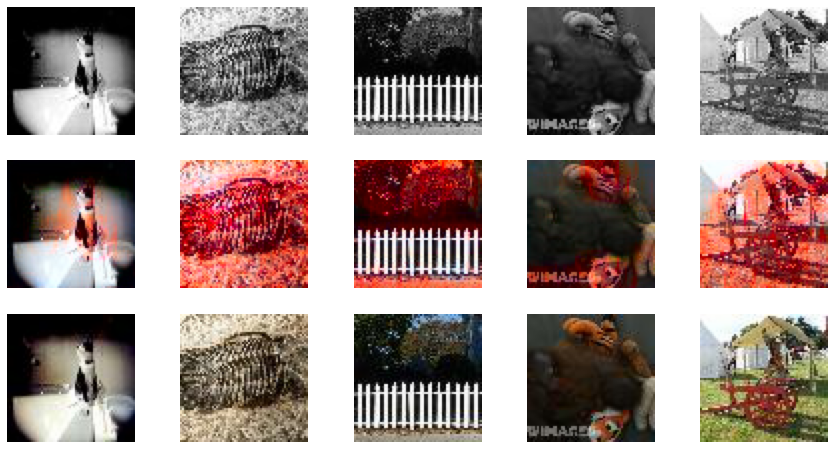

 35%|███▍      | 22/63 [00:27<00:50,  1.23s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 43 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 56 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 185 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


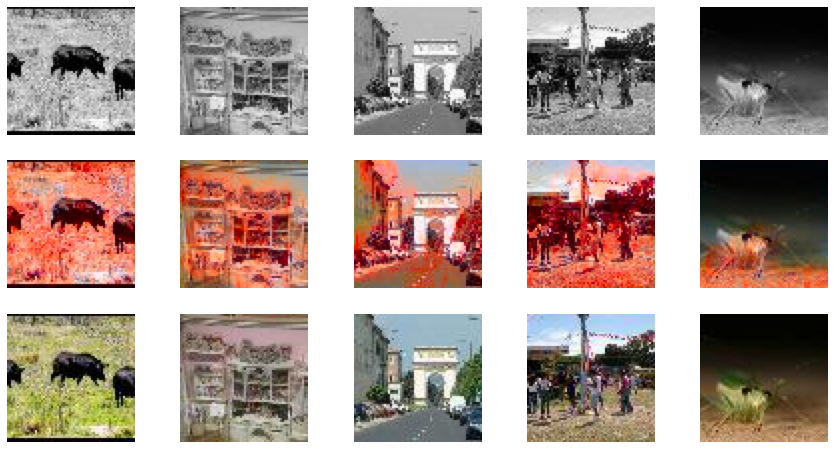

 37%|███▋      | 23/63 [00:28<00:48,  1.20s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 89 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


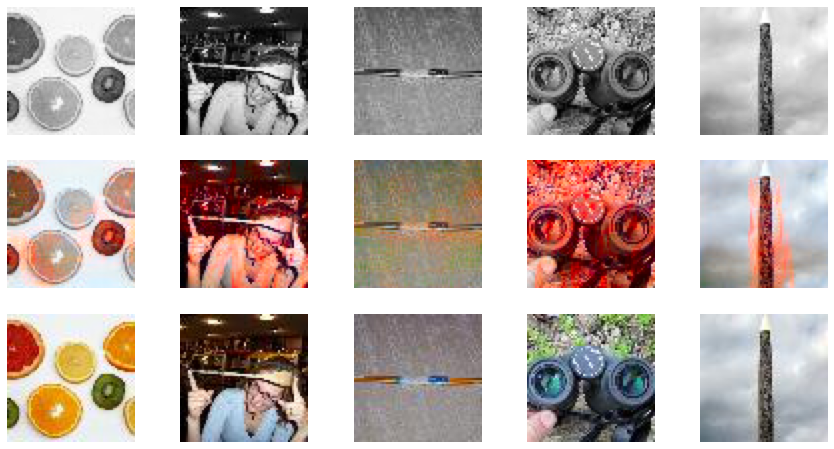

 38%|███▊      | 24/63 [00:29<00:45,  1.18s/it]

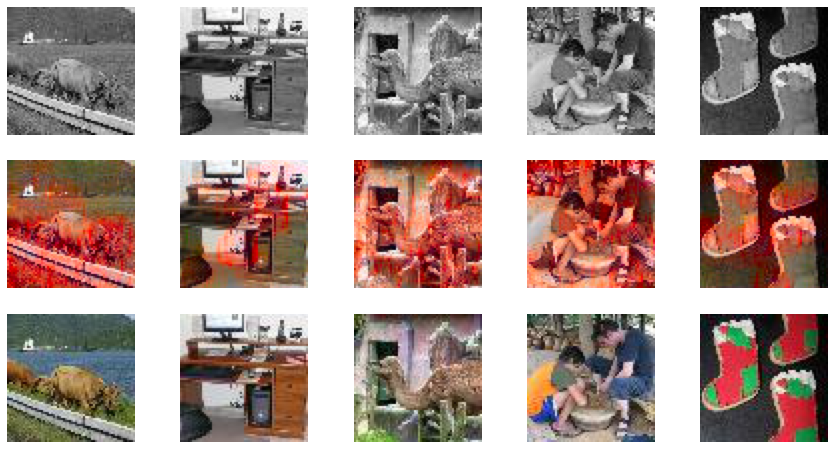

 40%|███▉      | 25/63 [00:30<00:43,  1.15s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 64 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


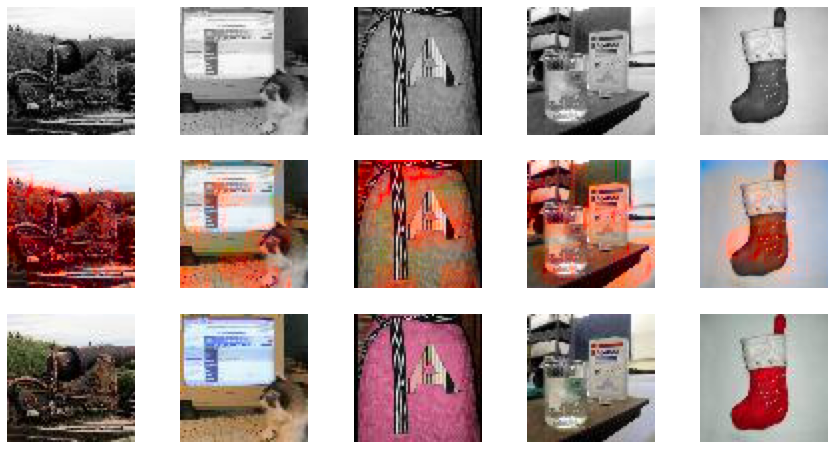

 41%|████▏     | 26/63 [00:31<00:45,  1.23s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 104 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


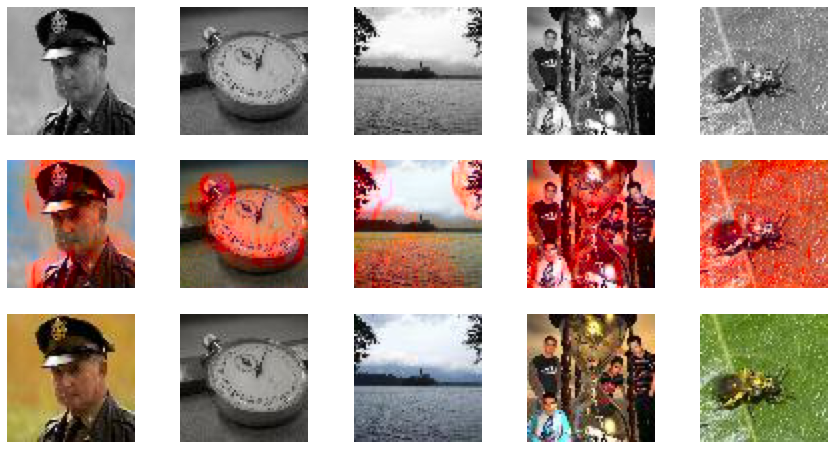

 43%|████▎     | 27/63 [00:32<00:43,  1.20s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 145 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 33 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


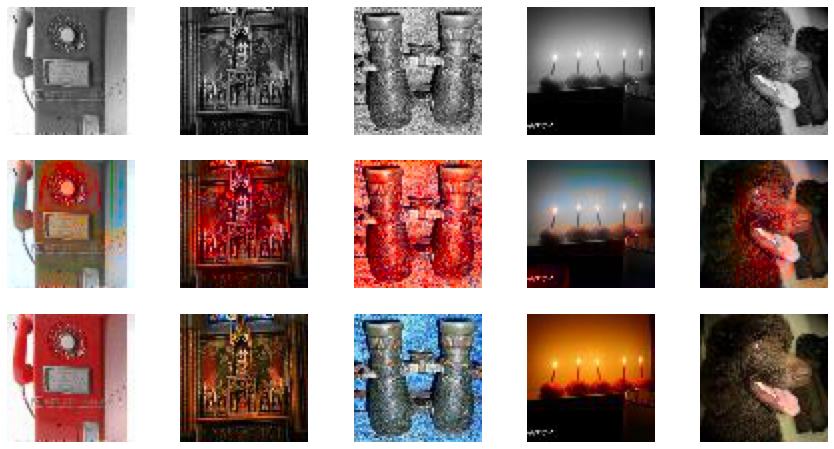

 44%|████▍     | 28/63 [00:34<00:41,  1.19s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 78 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


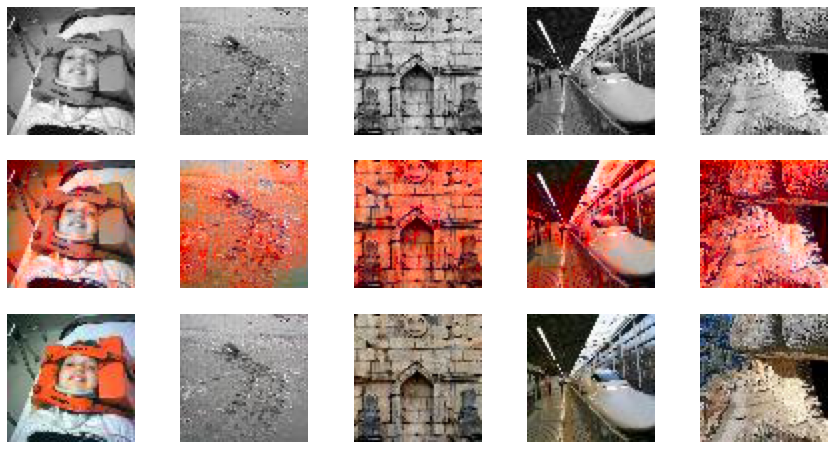

 46%|████▌     | 29/63 [00:35<00:39,  1.17s/it]

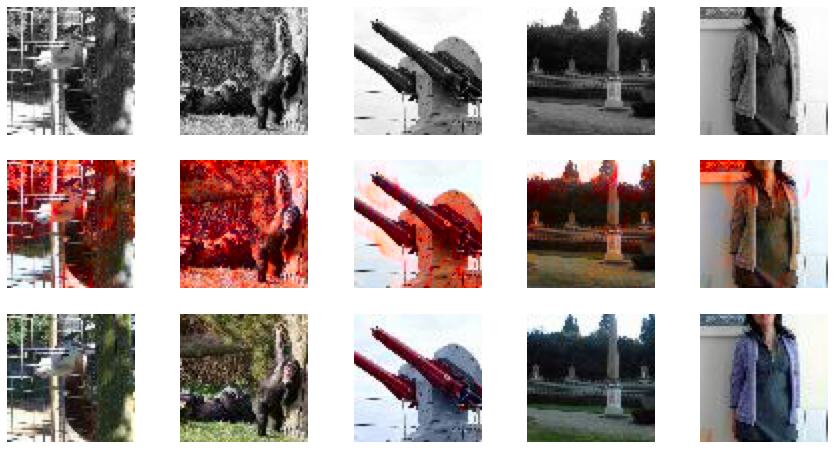

 48%|████▊     | 30/63 [00:36<00:40,  1.23s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 180 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


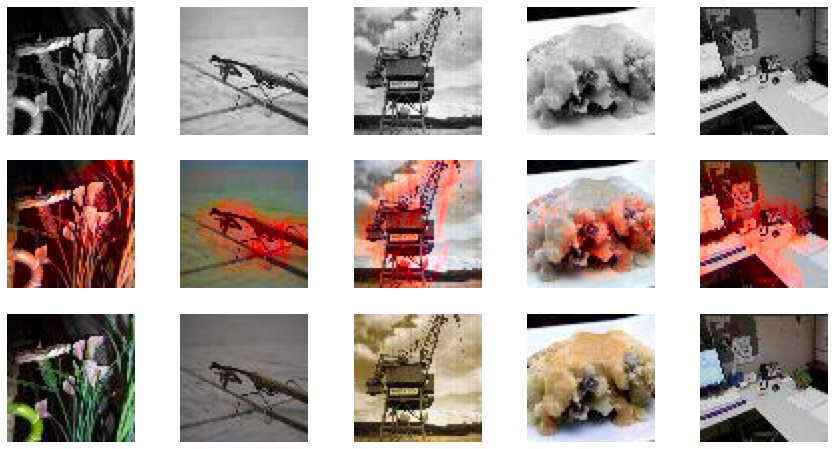

 49%|████▉     | 31/63 [00:37<00:38,  1.20s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 63 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


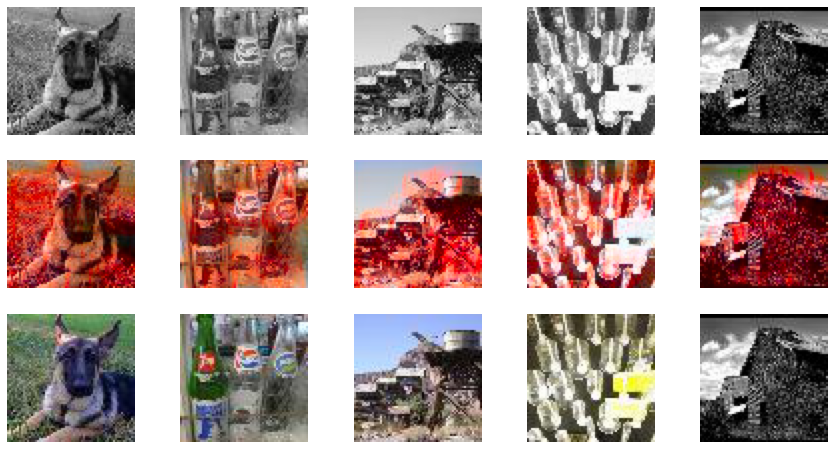

 51%|█████     | 32/63 [00:38<00:36,  1.19s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 392 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 94 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


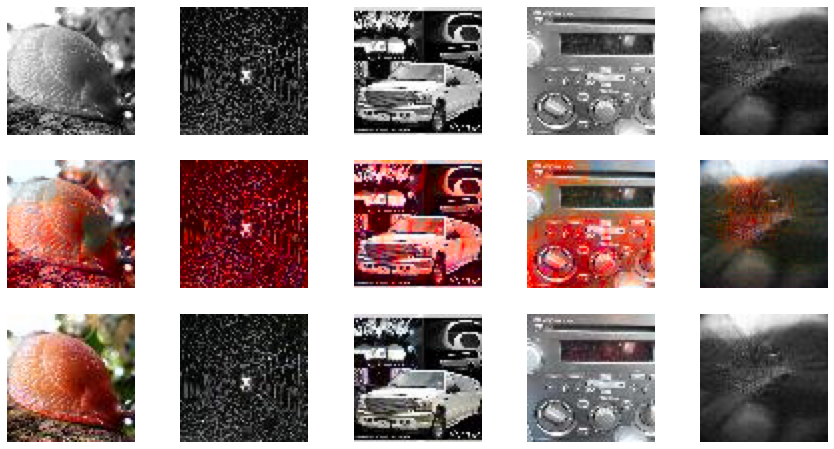

 52%|█████▏    | 33/63 [00:40<00:35,  1.18s/it]

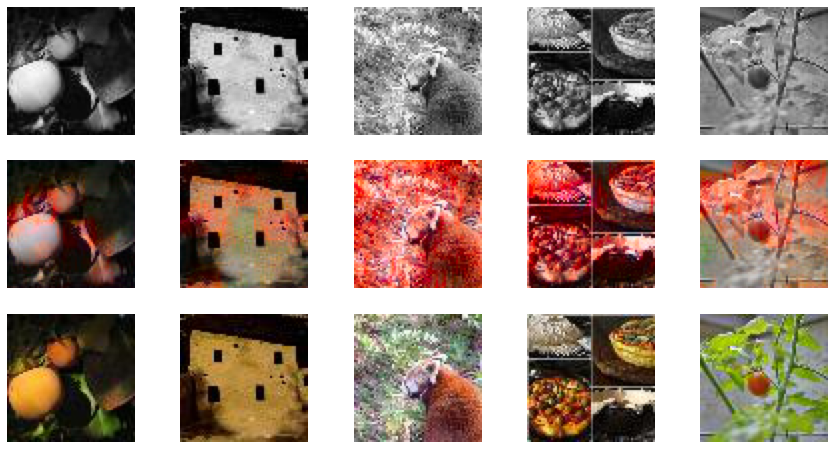

 54%|█████▍    | 34/63 [00:41<00:33,  1.15s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 124 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 67 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


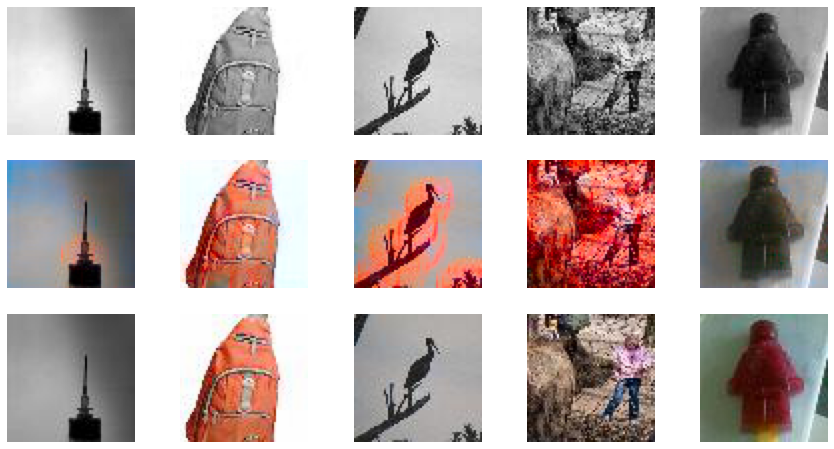

 56%|█████▌    | 35/63 [00:42<00:34,  1.23s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 61 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 166 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 46 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 165 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


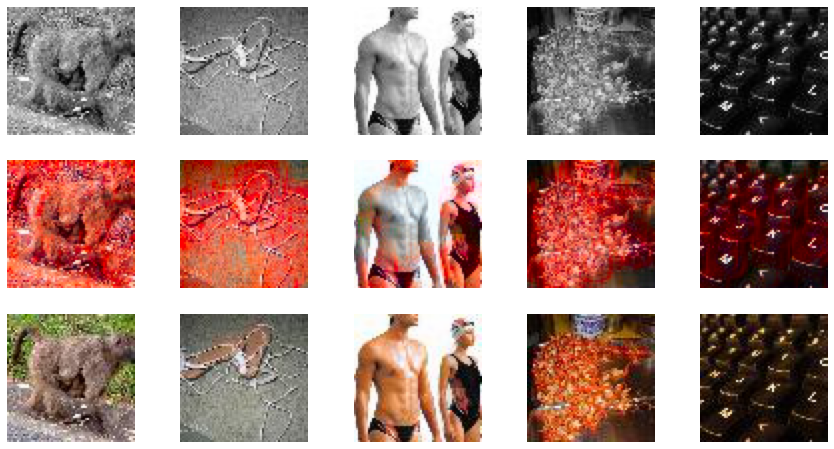

 57%|█████▋    | 36/63 [00:43<00:32,  1.22s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 101 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


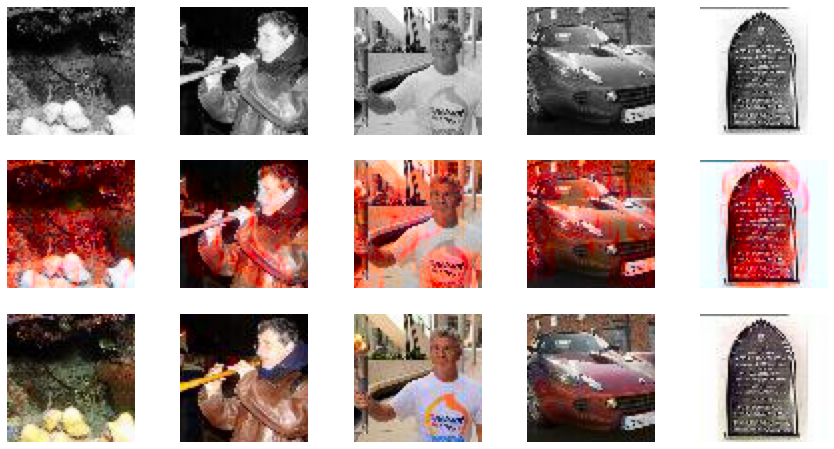

 59%|█████▊    | 37/63 [00:44<00:31,  1.20s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 262 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 97 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


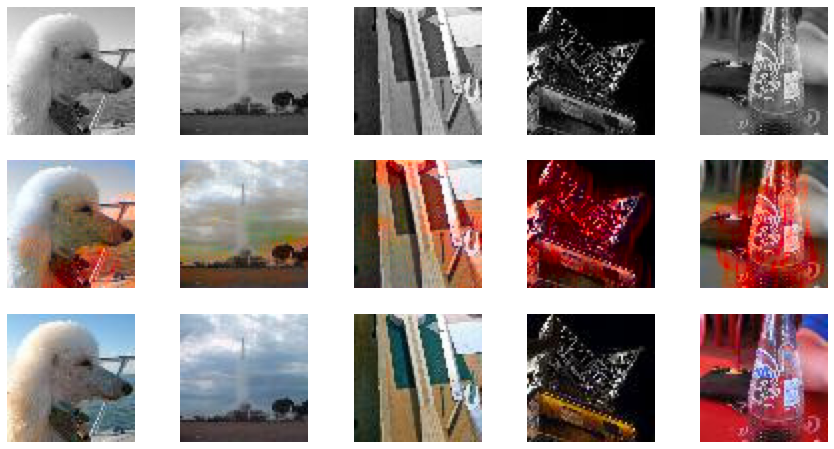

 60%|██████    | 38/63 [00:46<00:29,  1.19s/it]

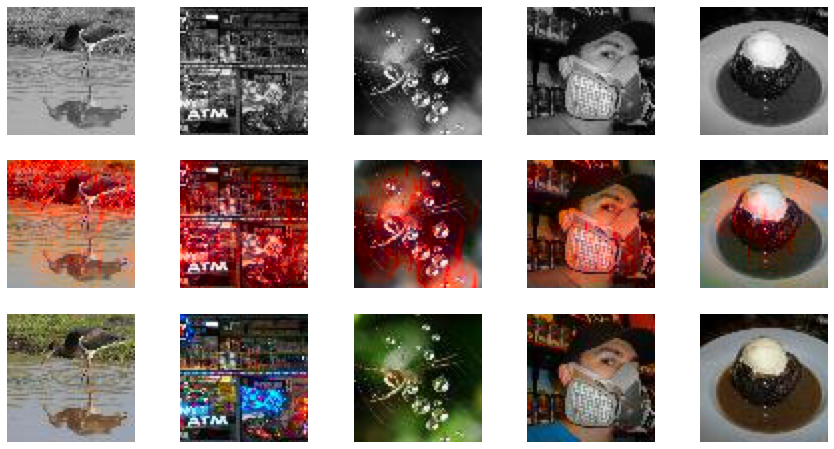

 62%|██████▏   | 39/63 [00:47<00:29,  1.25s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 103 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


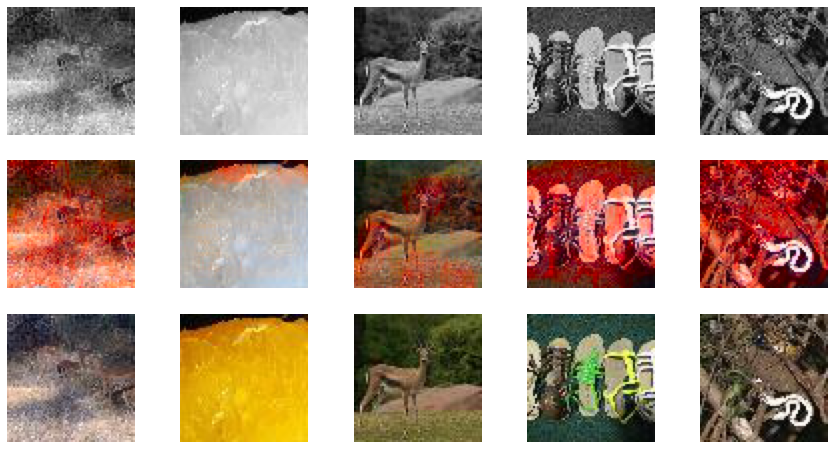

 63%|██████▎   | 40/63 [00:48<00:28,  1.23s/it]

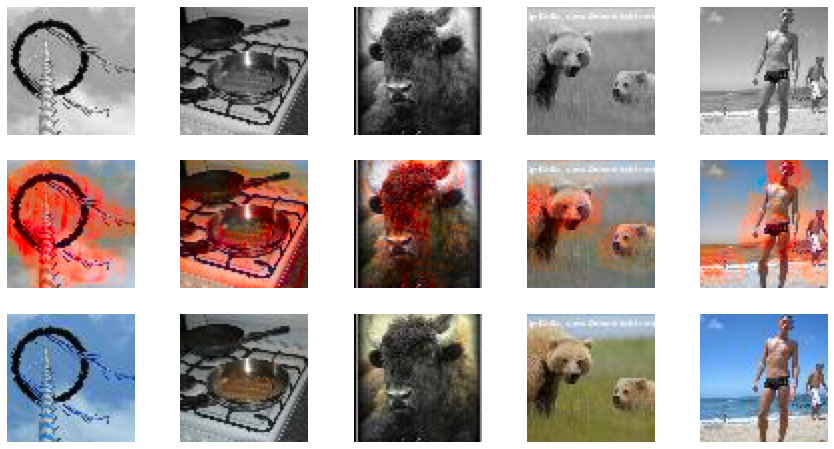

 65%|██████▌   | 41/63 [00:49<00:26,  1.19s/it]

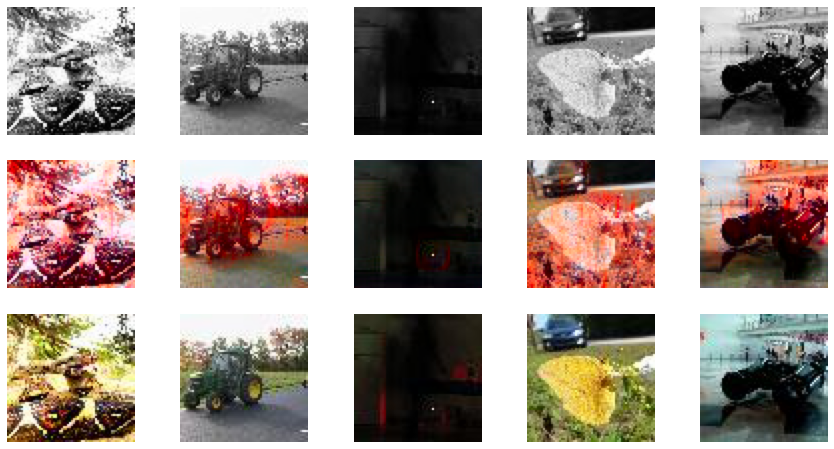

 67%|██████▋   | 42/63 [00:50<00:24,  1.17s/it]

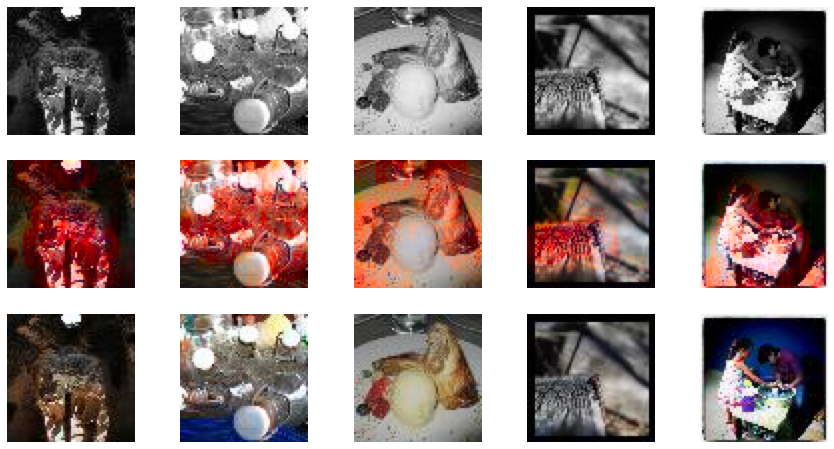

 68%|██████▊   | 43/63 [00:52<00:24,  1.23s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 57 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


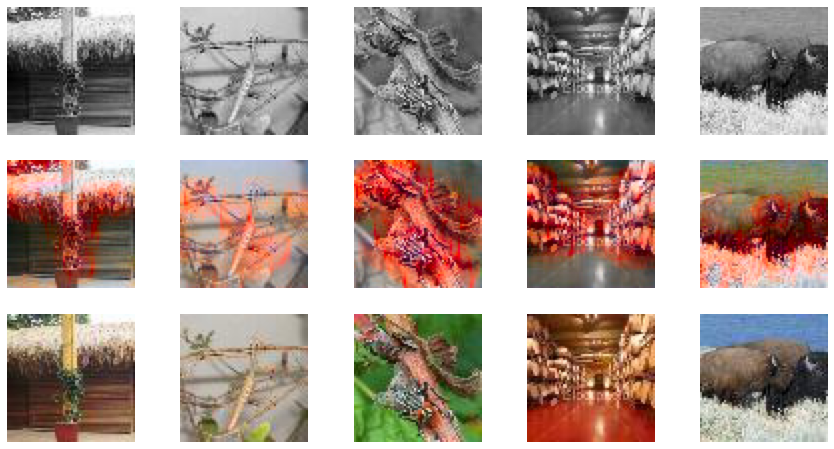

 70%|██████▉   | 44/63 [00:53<00:23,  1.23s/it]

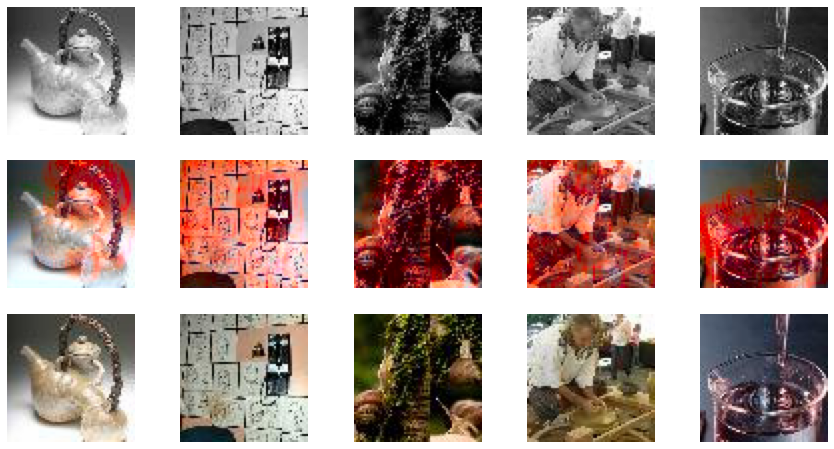

 71%|███████▏  | 45/63 [00:54<00:21,  1.19s/it]

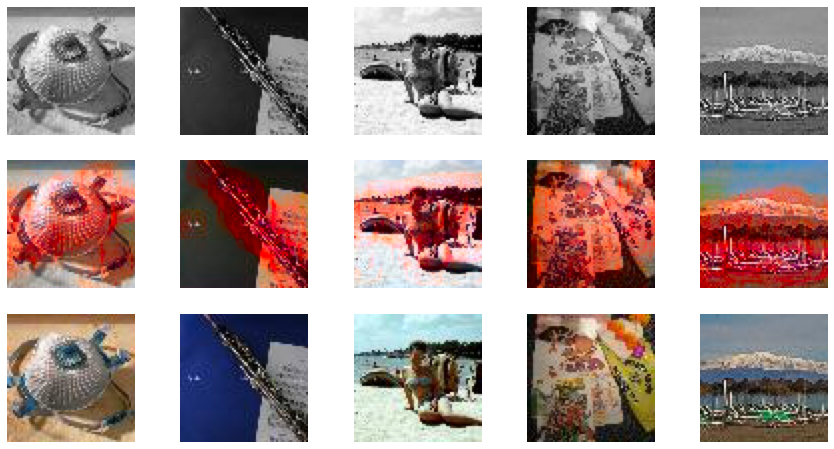

 73%|███████▎  | 46/63 [00:55<00:19,  1.17s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 36 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


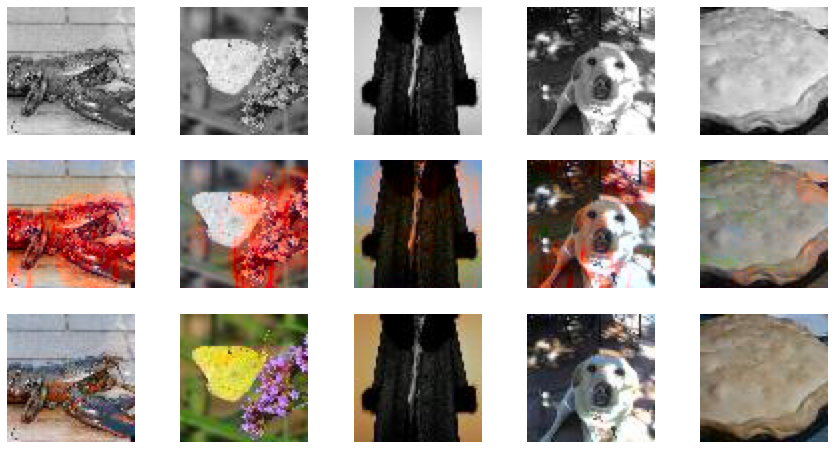

 75%|███████▍  | 47/63 [00:57<00:20,  1.26s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 128 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 153 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


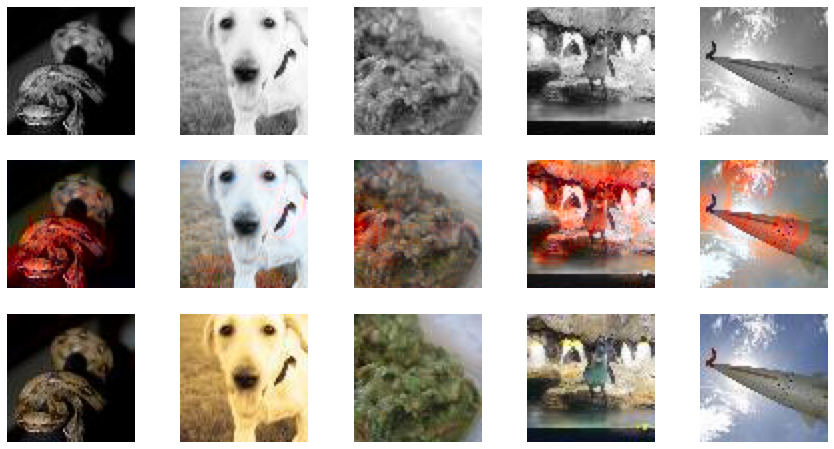

 76%|███████▌  | 48/63 [00:58<00:18,  1.24s/it]

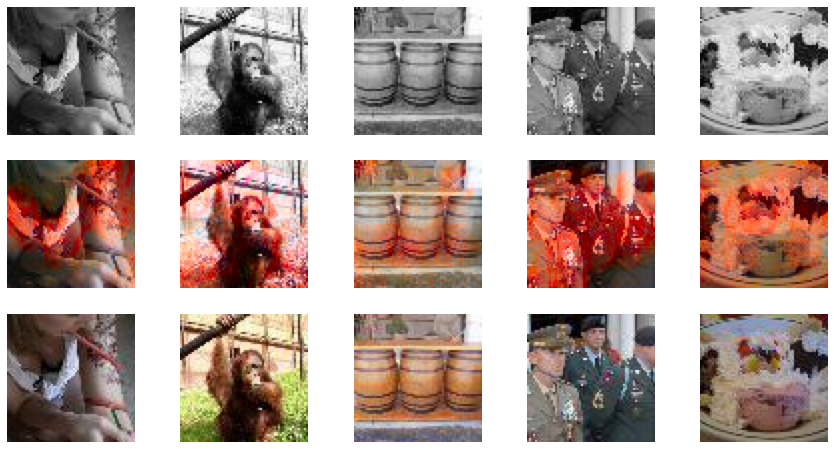

 78%|███████▊  | 49/63 [00:59<00:17,  1.22s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 134 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


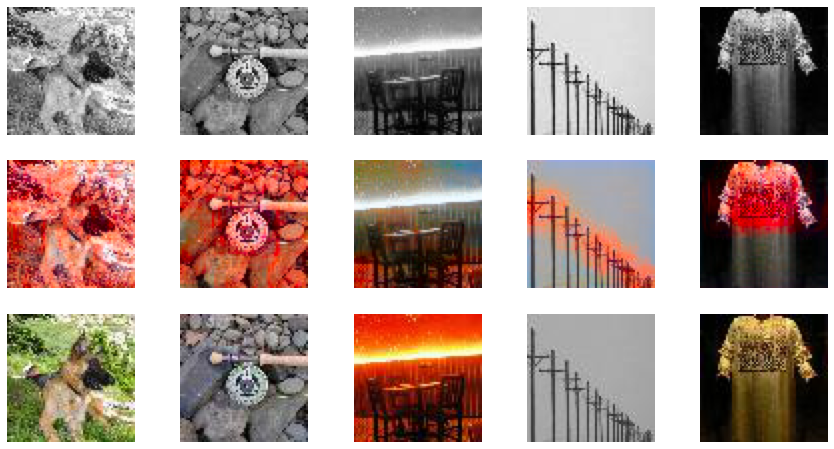

 79%|███████▉  | 50/63 [01:00<00:15,  1.23s/it]

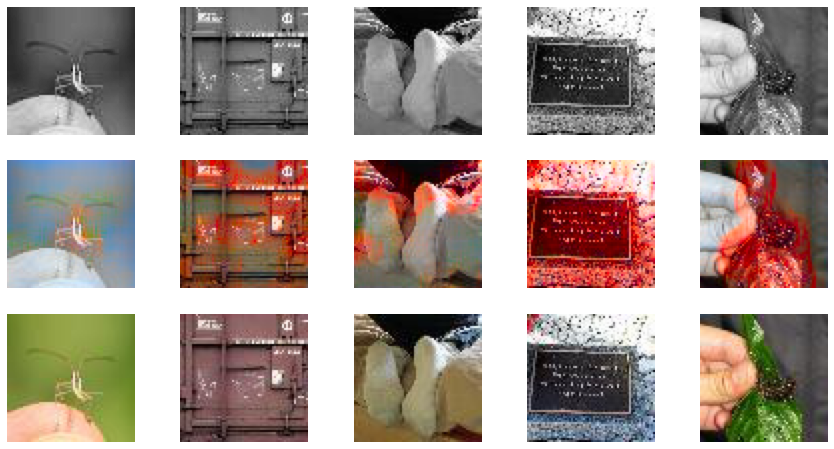

 81%|████████  | 51/63 [01:01<00:14,  1.20s/it]

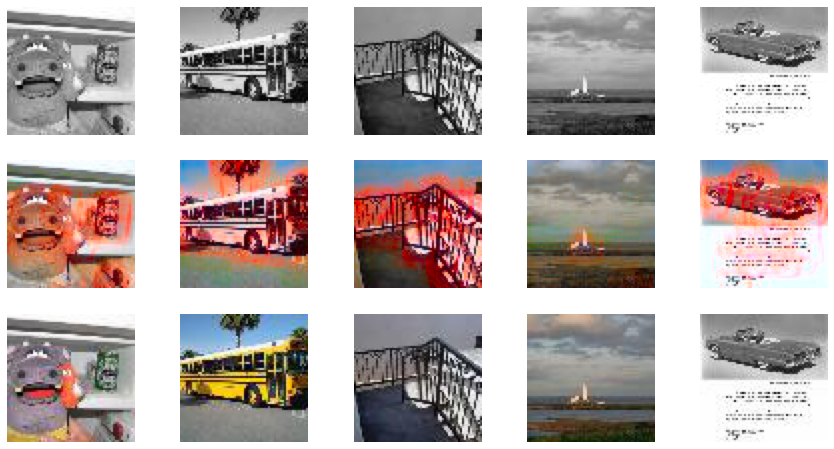

 83%|████████▎ | 52/63 [01:03<00:14,  1.27s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 110 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


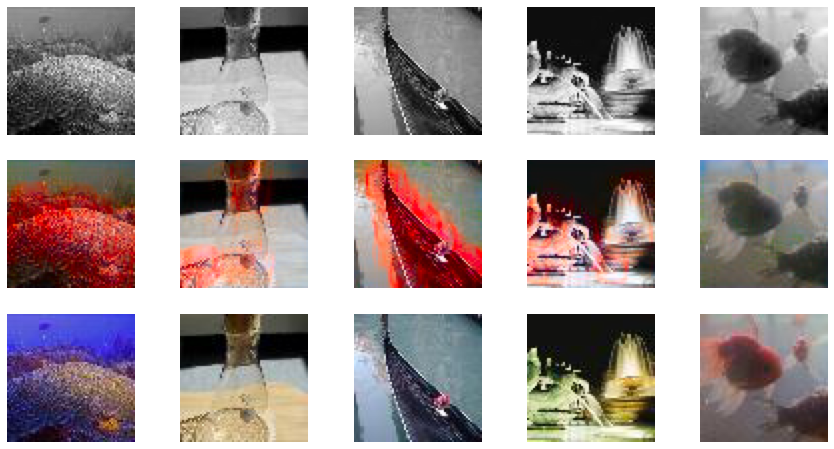

 84%|████████▍ | 53/63 [01:04<00:13,  1.31s/it]

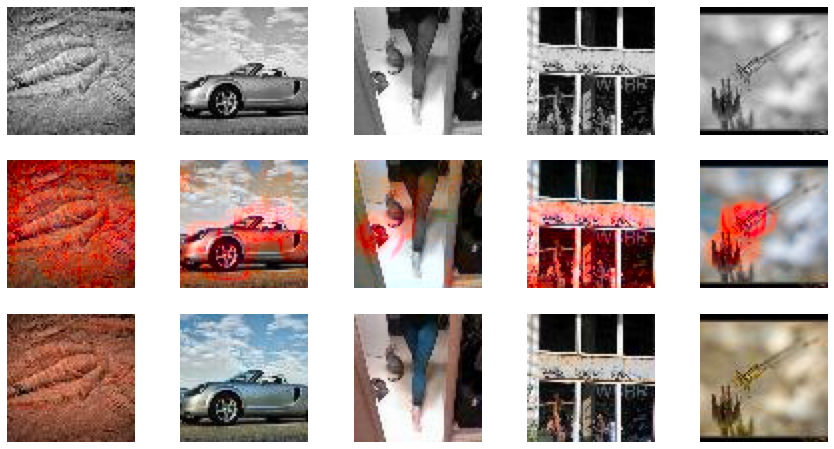

 86%|████████▌ | 54/63 [01:06<00:11,  1.30s/it]

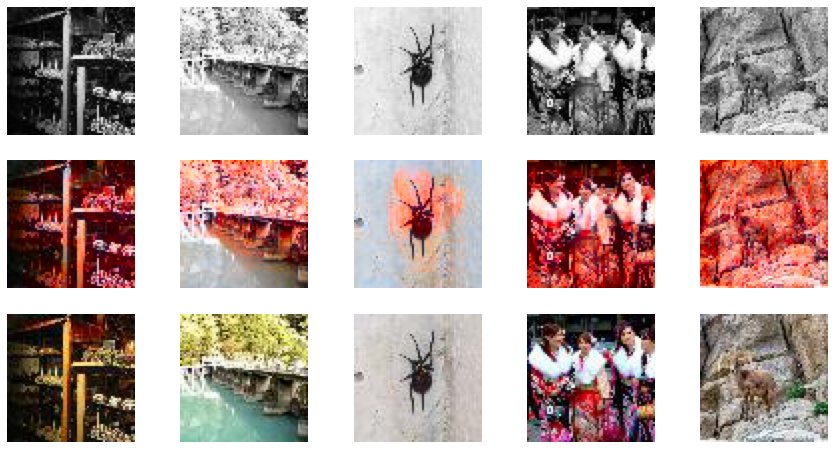

 87%|████████▋ | 55/63 [01:07<00:10,  1.28s/it]

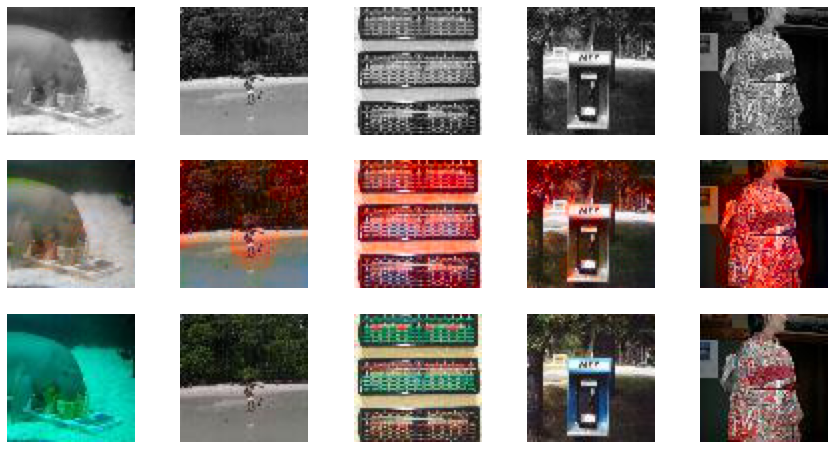

 89%|████████▉ | 56/63 [01:08<00:09,  1.31s/it]

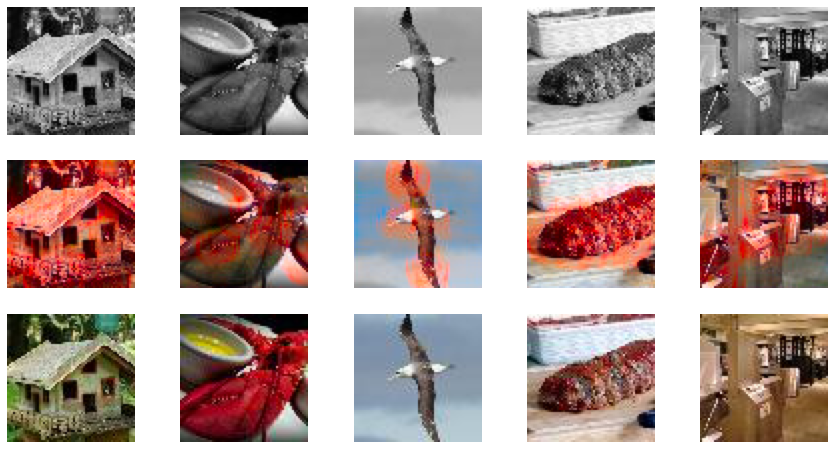

 90%|█████████ | 57/63 [01:09<00:07,  1.26s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 123 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


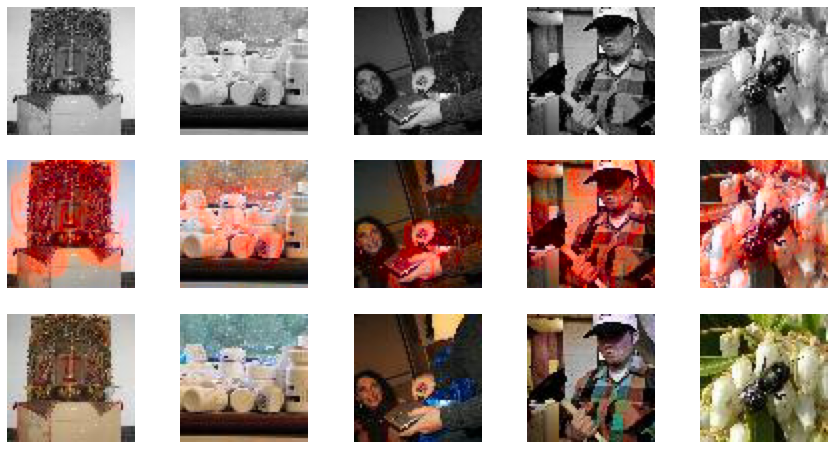

 92%|█████████▏| 58/63 [01:11<00:06,  1.27s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 66 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


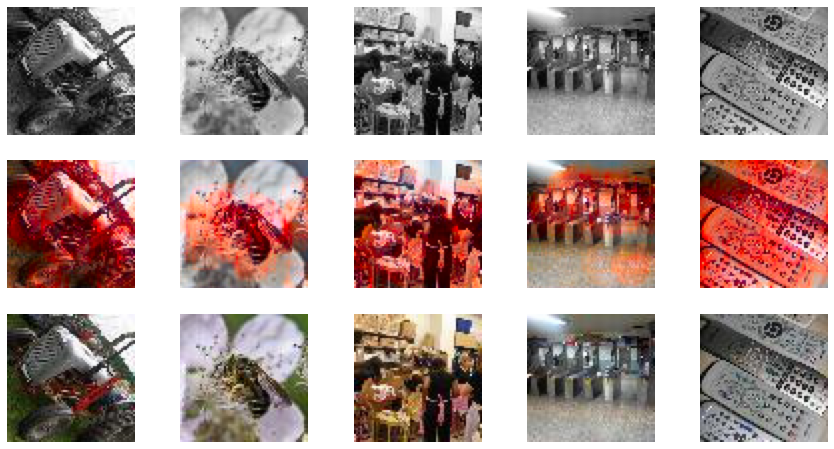

 94%|█████████▎| 59/63 [01:12<00:05,  1.27s/it]/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 189 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


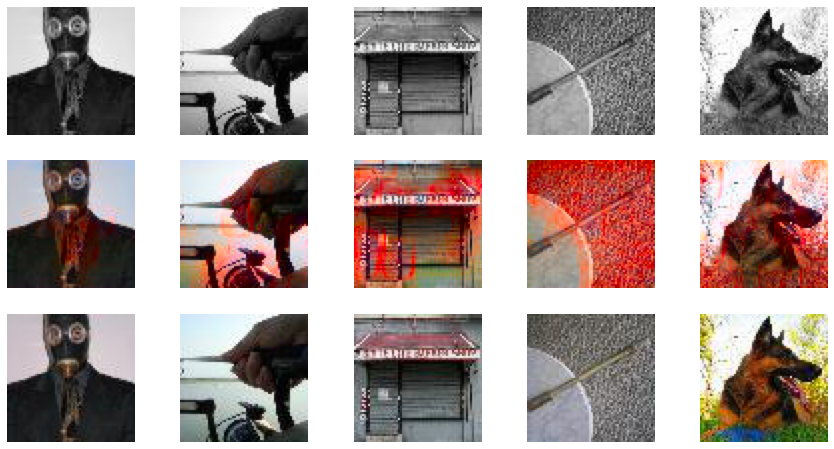

 95%|█████████▌| 60/63 [01:13<00:04,  1.36s/it]

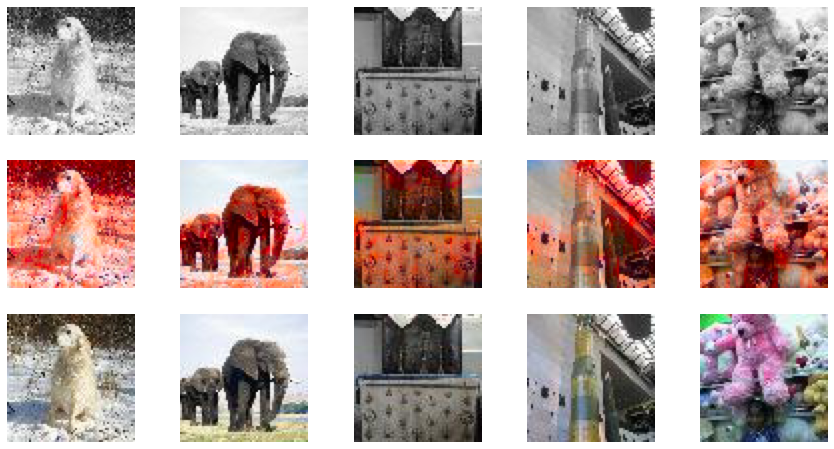

 97%|█████████▋| 61/63 [01:15<00:02,  1.31s/it]

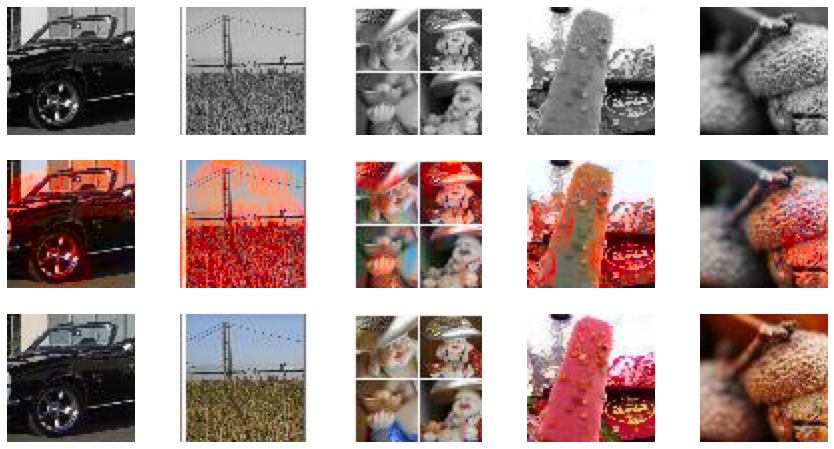

 98%|█████████▊| 62/63 [01:16<00:01,  1.27s/it]

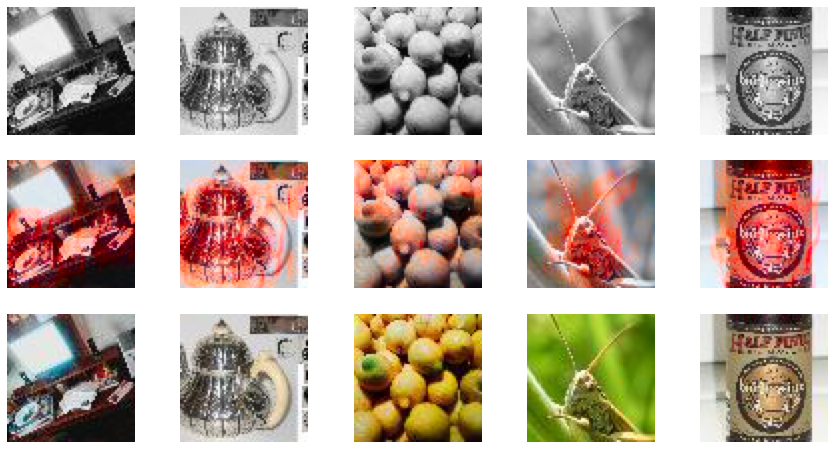

100%|██████████| 63/63 [01:17<00:00,  1.24s/it]


In [ ]:
data = next(iter(test_dl))
for data in tqdm(test_dl):
  visualize(model, data, save=False)


**Answer**:
The results eventhough not the best still I think is fairly good given our model was only trained on hourse images. 

We can see our model does pretty well with predicting green and red colors in images however it almost always makes some incorrect red predictions. This could be because since our model has only been trained on horse images it has leanred to properly color horses (mostly brown and black) as redish brown and so now that it sees these other objects like fruits and cans, it decides it should have some redish color like the horses as well since that color was very common in all horse images. Also we can see the model predicts green and blue background very well since most of our train set horse images also has green background grass and blue sky.

This tell us that the model is learning, only to improve the peformance we need a bigger datatset and also need to train for longer. Also if we use 256x256 images instead of 32x32 we would get even better resolution of the color predcitions.

### Saving to HTML
Detailed instructions for saving to HTML can be found <a href="https://stackoverflow.com/questions/53460051/convert-ipynb-notebook-to-html-in-google-colab/64487858#64487858">here</a>. Provided below are a summary of the instructions:

(1) download your ipynb file by clicking on File->Download.ipynb

(2) reupload your file to the temporary Google Colab storage (you can access the temporary storage from the tab to the left)

(3) run the following:

In [ ]:
%%shell
jupyter nbconvert --to html /content/LAB_3_Generating_Data.ipynb

[NbConvertApp] Converting notebook /content/LAB_3_Generating_Data.ipynb to html
[NbConvertApp] Writing 184130333 bytes to /content/LAB_3_Generating_Data.html


(4) the html file will be available for download in the temporary Google Colab storage

(5) review the html file and make sure all the results are visible before submitting your assignment to Quercus